In [1]:
import os
# os.environ["CUDA_VISIBLE_DEVICES"] = "0,1,2,3"
from diffusers import UNet2DConditionModel, DDPMScheduler
import torch
from torch.optim import AdamW
from dataset import ADNIDatasetSlicesInOrder
from torch.utils.data import DataLoader
from utils import load_trained_model, load_trained_embedder, plot_batch_slices, normalise_intensity_per_slice
import numpy as np
import matplotlib.pyplot as plt
from sample import sample_next_slices, sample_iteratively, get_index_encoding

/cim/ehoney/ecse626proj/venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [3]:
batch_size = 4

## Experiments 8, 9

In [21]:
num_train_timesteps = 256
experiment_num = '9_2'
slices_at_once = 2
symmetric_normalisation = True

In [22]:
model = UNet2DConditionModel(
    sample_size=128,
    in_channels=2*slices_at_once, #16
    out_channels=slices_at_once, #8 #initialise to maximum and compute loss only for indexed slices
    down_block_types=("DownBlock2D", "DownBlock2D", "DownBlock2D", "DownBlock2D", "CrossAttnDownBlock2D"),
    mid_block_type=None,
    up_block_types=("CrossAttnUpBlock2D", "UpBlock2D", "UpBlock2D", "UpBlock2D", "UpBlock2D"),
    # not sure about what the lower arguments do
    block_out_channels=(64, 128, 256, 512, 1024), #start with 64? no deeper than 1024
    layers_per_block=2, #default
    # cross_attention_dim=1, # ~concat one-hot encodings of condition and target slices~ NO now instead just one 128 vector with labels 0,1,2
    attention_head_dim=8, #default
    norm_num_groups=32, #default
    use_linear_projection=True #DIFFERENT
)
model.to(device)

UNet2DConditionModel(
  (conv_in): Conv2d(4, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=64, out_features=256, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=256, out_features=256, bias=True)
  )
  (down_blocks): ModuleList(
    (0): DownBlock2D(
      (resnets): ModuleList(
        (0-1): 2 x ResnetBlock2D(
          (norm1): GroupNorm(32, 64, eps=1e-05, affine=True)
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (time_emb_proj): Linear(in_features=256, out_features=64, bias=True)
          (norm2): GroupNorm(32, 64, eps=1e-05, affine=True)
          (dropout): Dropout(p=0.0, inplace=False)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (nonlinearity): SiLU()
        )
      )
      (downsamplers): ModuleList(
        (0): Downsample2D(
          (conv): Conv2d(64

In [23]:
num_slice_indices = 128 // slices_at_once
embedding_dim = 1280
slice_embedder = torch.nn.Embedding(num_slice_indices, embedding_dim)
slice_embedder.to(device)

Embedding(64, 1280)

In [24]:
noise_scheduler = DDPMScheduler(num_train_timesteps=num_train_timesteps)

In [25]:
load_trained_model(model, f'experiment{experiment_num}/latest_ckpt.pth.tar')

Checkpoint loaded from epoch 1500.


In [26]:
load_trained_embedder(slice_embedder, f'experiment{experiment_num}/latest_ckpt.pth.tar' )

Checkpoint loaded from epoch 1500.


In [27]:
noised_target_slices = torch.randn(batch_size, slices_at_once, 128, 128, device=device)

In [28]:
condition_slices = torch.zeros_like(noised_target_slices)

In [29]:
first_target_slice_indices = torch.zeros(4, dtype=torch.int).to(device)

In [30]:
encoder_hidden_states = get_index_encoding('embedded', first_target_slice_indices, slices_at_once, slice_embedder)

In [31]:
target_slices = sample_next_slices(noised_target_slices, condition_slices, model, noise_scheduler, batch_size, device, encoder_hidden_states, verbose=True)

t is 255
t is 254
t is 253
t is 252
t is 251
t is 250
t is 249
t is 248
t is 247
t is 246
t is 245
t is 244
t is 243
t is 242
t is 241
t is 240
t is 239
t is 238
t is 237
t is 236
t is 235
t is 234
t is 233
t is 232
t is 231
t is 230
t is 229
t is 228
t is 227
t is 226
t is 225
t is 224
t is 223
t is 222
t is 221
t is 220
t is 219
t is 218
t is 217
t is 216
t is 215
t is 214
t is 213
t is 212
t is 211
t is 210
t is 209
t is 208
t is 207
t is 206
t is 205
t is 204
t is 203
t is 202
t is 201
t is 200
t is 199
t is 198
t is 197
t is 196
t is 195
t is 194
t is 193
t is 192
t is 191
t is 190
t is 189
t is 188
t is 187
t is 186
t is 185
t is 184
t is 183
t is 182
t is 181
t is 180
t is 179
t is 178
t is 177
t is 176
t is 175
t is 174
t is 173
t is 172
t is 171
t is 170
t is 169
t is 168
t is 167
t is 166
t is 165
t is 164
t is 163
t is 162
t is 161
t is 160
t is 159
t is 158
t is 157
t is 156
t is 155
t is 154
t is 153
t is 152
t is 151
t is 150
t is 149
t is 148
t is 147
t is 146
t is 145
t

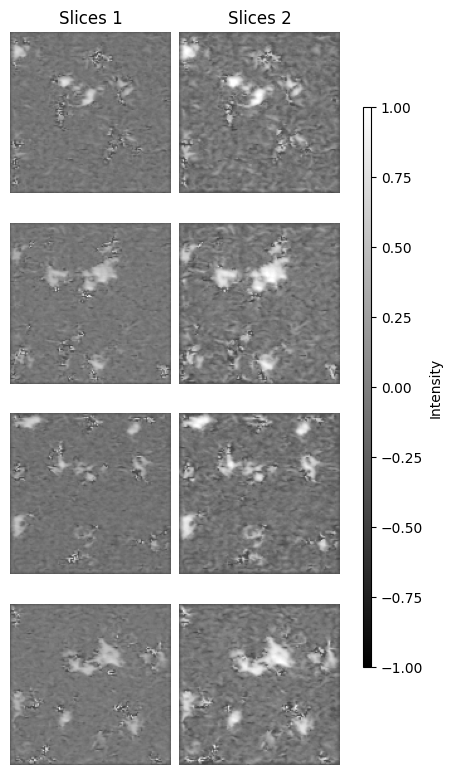

In [32]:
plot_batch_slices(target_slices, batch_size, slices=slices_at_once, vmin=-1)

In [33]:
noised_target_slices = torch.randn(batch_size, slices_at_once, 128, 128, device=device)

In [34]:
data_dir = "/cim/ehoney/ecse626proj/preprocessed_data"
train_dataset = ADNIDatasetSlicesInOrder(data_dir, sample_full_brain=True, symmetric_normalisation=True)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=8) # CHANGE to NUM_WORKERS=4

In [35]:
one_batch = next(iter(train_dataloader))

In [39]:
condition_start_index = 0

Condition slices populated from slice 0 to 2.


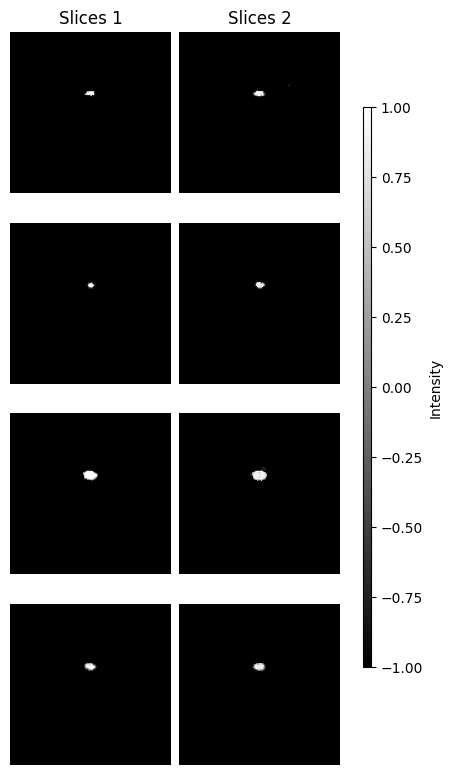

Sampling slices 2 to 4...
Generated slices in range [(tensor(-0.5207, device='cuda:0'), tensor(1., device='cuda:0'))]


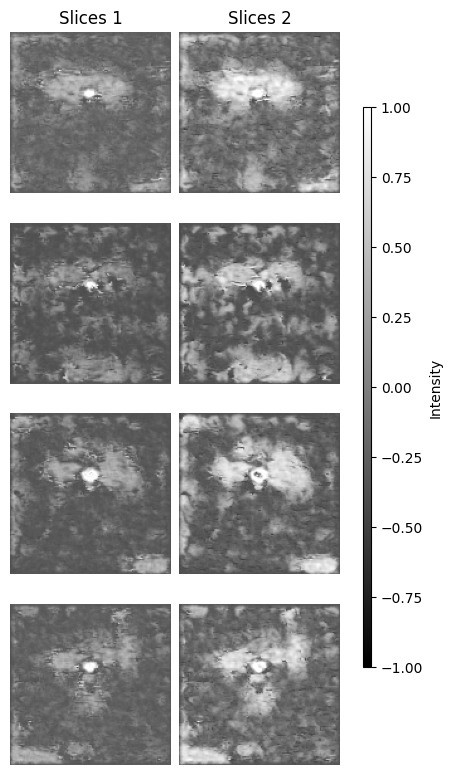

Complete.
Sampling slices 4 to 6...
Generated slices in range [(tensor(-0.7403, device='cuda:0'), tensor(1., device='cuda:0'))]


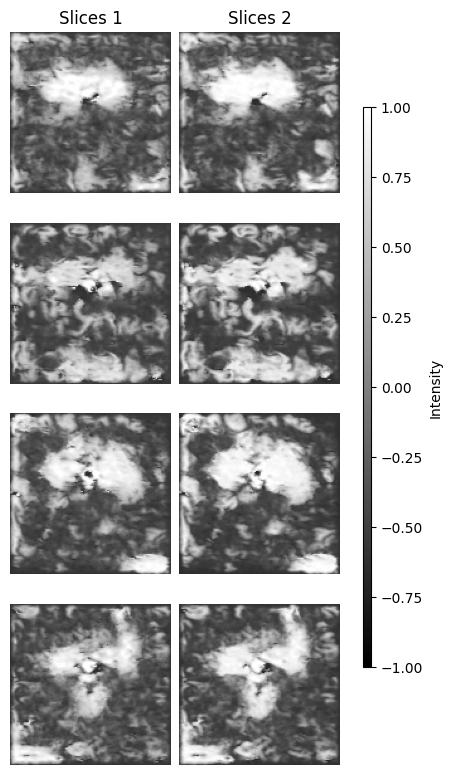

Complete.
Sampling slices 6 to 8...
Generated slices in range [(tensor(-0.8117, device='cuda:0'), tensor(1., device='cuda:0'))]


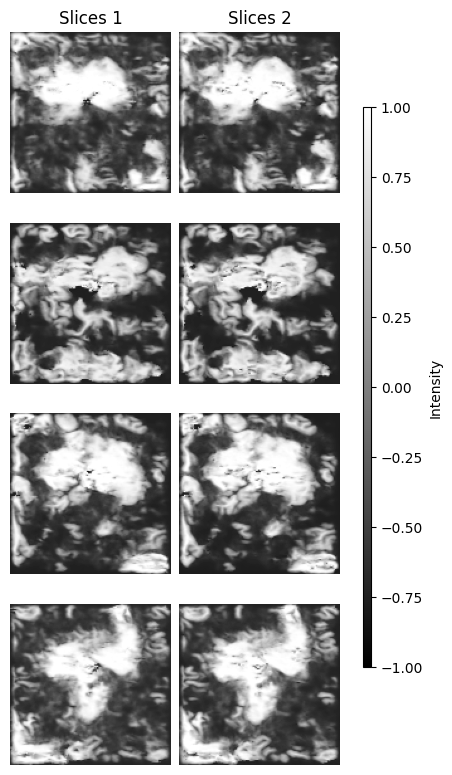

Complete.
Sampling slices 8 to 10...
Generated slices in range [(tensor(-0.8748, device='cuda:0'), tensor(1., device='cuda:0'))]


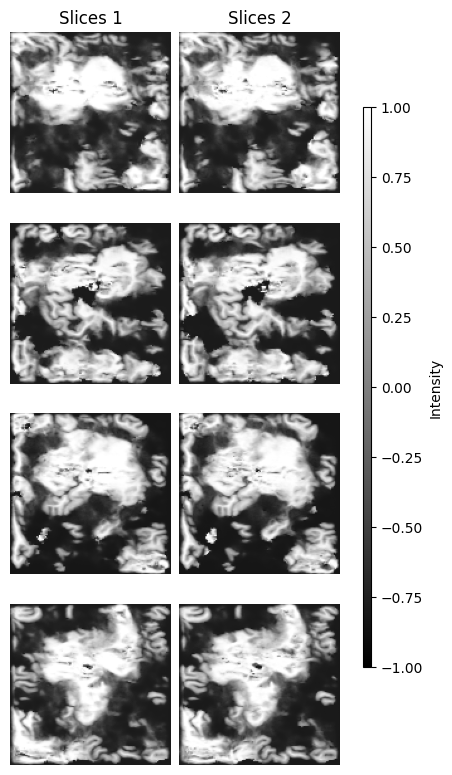

Complete.
Sampling slices 10 to 12...
Generated slices in range [(tensor(-0.9161, device='cuda:0'), tensor(1., device='cuda:0'))]


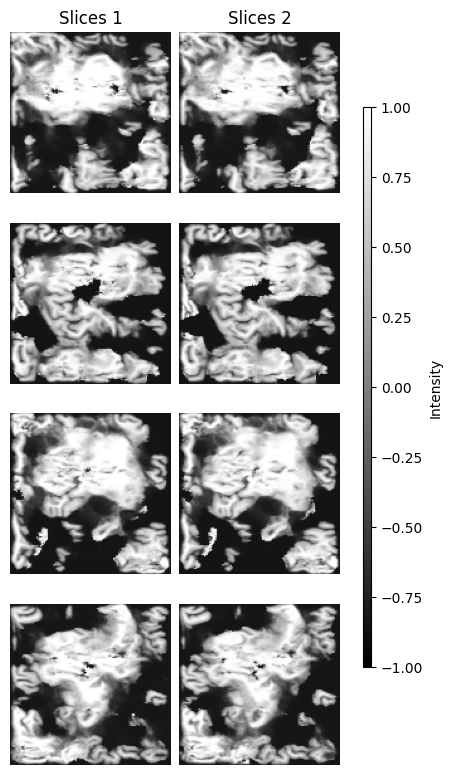

Complete.
Sampling slices 12 to 14...
Generated slices in range [(tensor(-0.9478, device='cuda:0'), tensor(1., device='cuda:0'))]


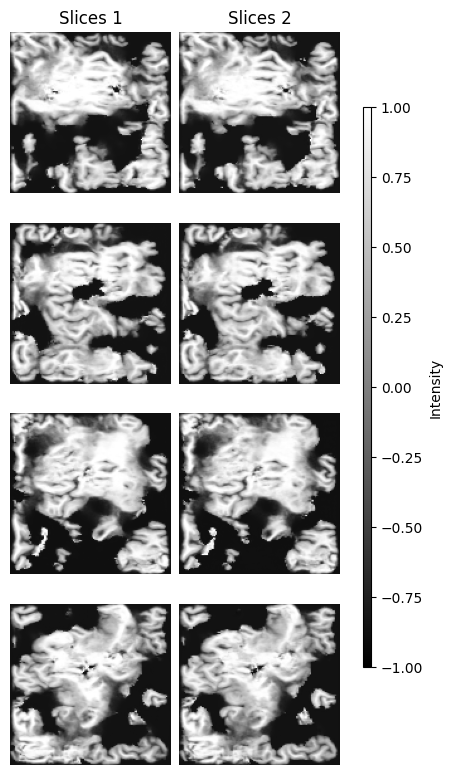

Complete.
Sampling slices 14 to 16...
Generated slices in range [(tensor(-0.9787, device='cuda:0'), tensor(1., device='cuda:0'))]


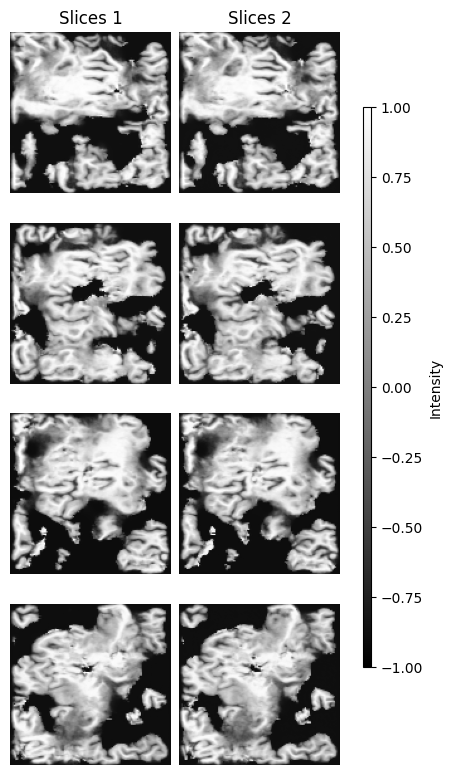

Complete.
Sampling slices 16 to 18...
Generated slices in range [(tensor(-0.9784, device='cuda:0'), tensor(1., device='cuda:0'))]


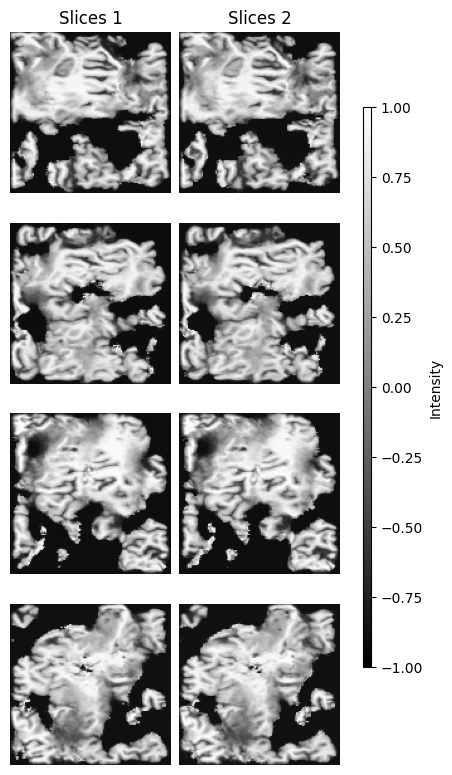

Complete.
Sampling slices 18 to 20...


KeyboardInterrupt: 

In [40]:
output_batch = sample_iteratively(condition_start_index, slices_at_once, one_batch, model, noise_scheduler, slice_embedder, batch_size, device, symmetric_normalisation, index_encoding_type='embedded', verbose=True)

## Experiment 7

In [4]:
num_train_timesteps = 256
experiment_num = '7'
slices_at_once = 4
symmetric_normalisation = True
index_encoding_type = 'index'

In [5]:
model = UNet2DConditionModel(
    sample_size=128,
    in_channels=2*slices_at_once, #16
    out_channels=slices_at_once, #8 #initialise to maximum and compute loss only for indexed slices
    down_block_types=("DownBlock2D", "DownBlock2D", "DownBlock2D", "DownBlock2D", "CrossAttnDownBlock2D"),
    mid_block_type=None,
    up_block_types=("CrossAttnUpBlock2D", "UpBlock2D", "UpBlock2D", "UpBlock2D", "UpBlock2D"),
    # not sure about what the lower arguments do
    block_out_channels=(64, 128, 256, 512, 1024), #start with 64? no deeper than 1024
    layers_per_block=2, #default
    cross_attention_dim=1, # ~concat one-hot encodings of condition and target slices~ NO now instead just one 128 vector with labels 0,1,2
    attention_head_dim=8, #default
    norm_num_groups=32, #default
    use_linear_projection=True #DIFFERENT
)
print(f"Model initialised. Number of model parameters: {model.num_parameters()}.")
model.to(device)

Model initialised. Number of model parameters: 286108164.


UNet2DConditionModel(
  (conv_in): Conv2d(8, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=64, out_features=256, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=256, out_features=256, bias=True)
  )
  (down_blocks): ModuleList(
    (0): DownBlock2D(
      (resnets): ModuleList(
        (0-1): 2 x ResnetBlock2D(
          (norm1): GroupNorm(32, 64, eps=1e-05, affine=True)
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (time_emb_proj): Linear(in_features=256, out_features=64, bias=True)
          (norm2): GroupNorm(32, 64, eps=1e-05, affine=True)
          (dropout): Dropout(p=0.0, inplace=False)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (nonlinearity): SiLU()
        )
      )
      (downsamplers): ModuleList(
        (0): Downsample2D(
          (conv): Conv2d(64

In [6]:
noise_scheduler = DDPMScheduler(num_train_timesteps=num_train_timesteps)

In [7]:
load_trained_model(model, f'experiment{experiment_num}/latest_ckpt.pth.tar')

/cim/ehoney/ecse626proj/utils.py:102: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(ckpt_path)


Checkpoint loaded from epoch 1500.


In [8]:
noised_target_slices = torch.randn(batch_size, slices_at_once, 128, 128, device=device)

In [50]:
condition_slices = torch.zeros_like(noised_target_slices)

In [51]:
first_target_slice_indices = torch.zeros(4, dtype=torch.int).to(device)

In [53]:
encoder_hidden_states = get_index_encoding(index_encoding_type, first_target_slice_indices, slices_at_once, slice_embedder)

In [56]:
target_slices = sample_next_slices(noised_target_slices, condition_slices, model, noise_scheduler, batch_size, device, encoder_hidden_states.float(), verbose=True)

t is 255
t is 254
t is 253
t is 252
t is 251
t is 250
t is 249
t is 248
t is 247
t is 246
t is 245
t is 244
t is 243
t is 242
t is 241
t is 240
t is 239
t is 238
t is 237
t is 236
t is 235
t is 234
t is 233
t is 232
t is 231
t is 230
t is 229
t is 228
t is 227
t is 226
t is 225
t is 224
t is 223
t is 222
t is 221
t is 220
t is 219
t is 218
t is 217
t is 216
t is 215
t is 214
t is 213
t is 212
t is 211
t is 210
t is 209
t is 208
t is 207
t is 206
t is 205
t is 204
t is 203
t is 202
t is 201
t is 200
t is 199
t is 198
t is 197
t is 196
t is 195
t is 194
t is 193
t is 192
t is 191
t is 190
t is 189
t is 188
t is 187
t is 186
t is 185
t is 184
t is 183
t is 182
t is 181
t is 180
t is 179
t is 178
t is 177
t is 176
t is 175
t is 174
t is 173
t is 172
t is 171
t is 170
t is 169
t is 168
t is 167
t is 166
t is 165
t is 164
t is 163
t is 162
t is 161
t is 160
t is 159
t is 158
t is 157
t is 156
t is 155
t is 154
t is 153
t is 152
t is 151
t is 150
t is 149
t is 148
t is 147
t is 146
t is 145
t

/cim/ehoney/ecse626proj/utils.py:143: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Leave space for the colorbar


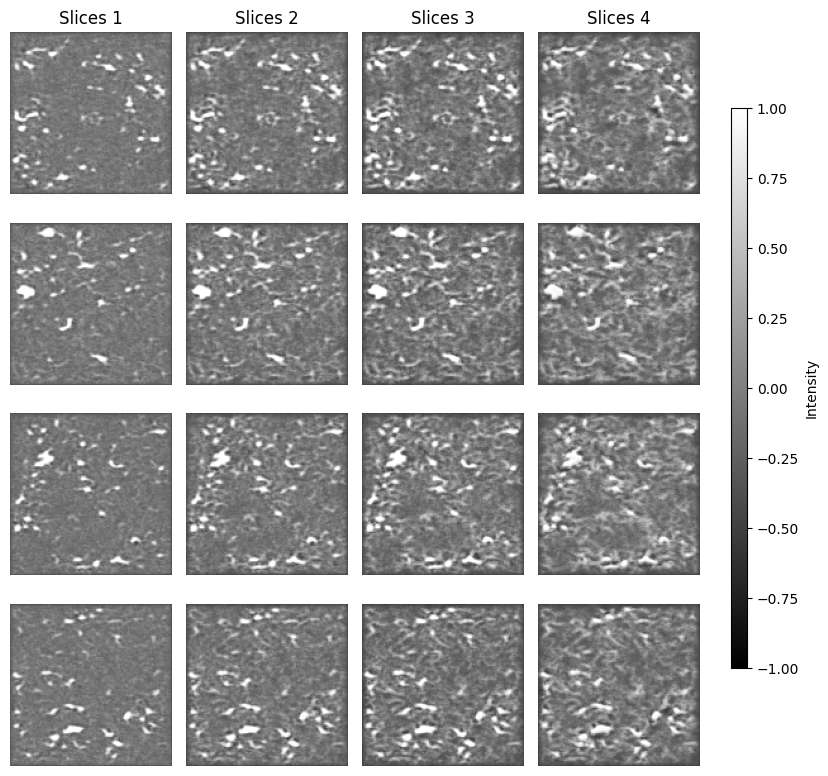

In [57]:
plot_batch_slices(target_slices, batch_size, slices=slices_at_once, vmin=-1)

In [9]:
noised_target_slices = torch.randn(batch_size, slices_at_once, 128, 128, device=device)

In [10]:
data_dir = "/cim/ehoney/ecse626proj/preprocessed_data"
train_dataset = ADNIDatasetSlicesInOrder(data_dir, sample_full_brain=True, symmetric_normalisation=True)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=8) # CHANGE to NUM_WORKERS=4

In [11]:
one_batch = next(iter(train_dataloader))

In [12]:
condition_start_index = 0

Condition slices populated from slice 0 to 4.


/cim/ehoney/ecse626proj/utils.py:143: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Leave space for the colorbar


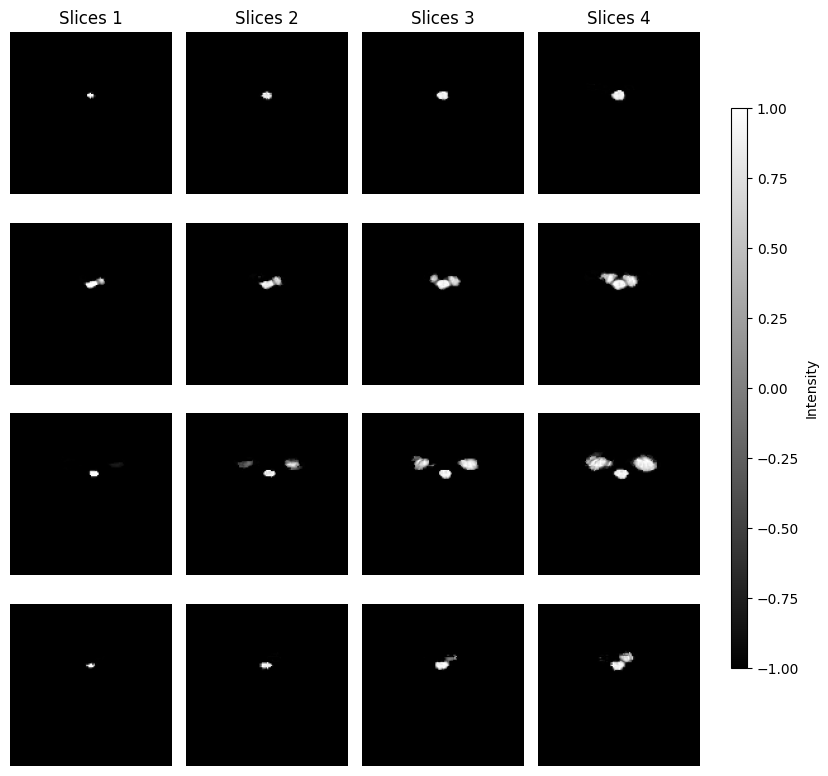

Sampling slices 4 to 8...
Generated slices in range [(tensor(-0.7008, device='cuda:0'), tensor(1., device='cuda:0'))]


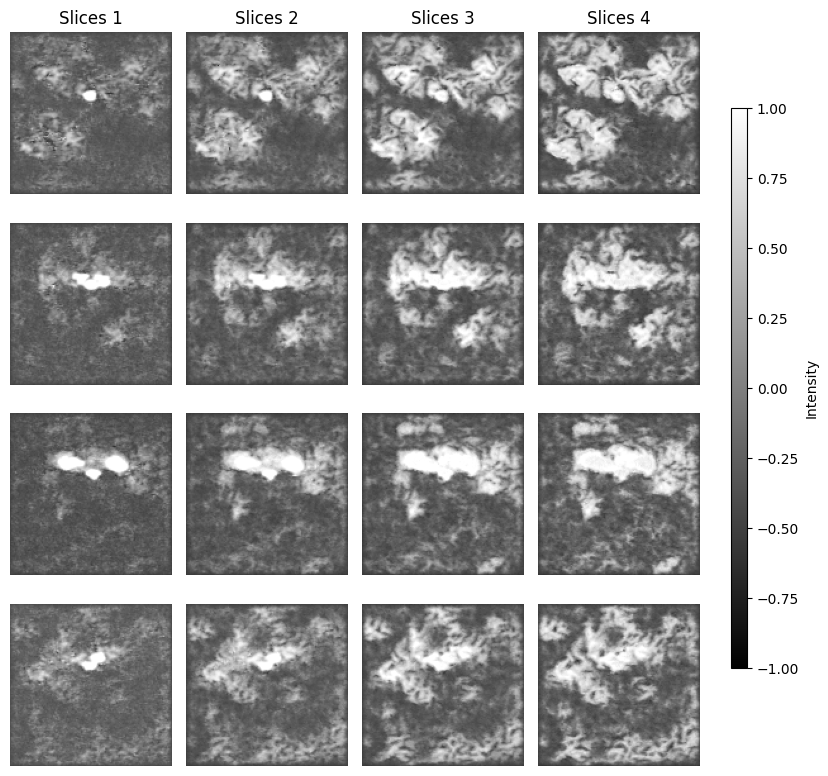

Complete.
Sampling slices 8 to 12...
Generated slices in range [(tensor(-0.8992, device='cuda:0'), tensor(1., device='cuda:0'))]


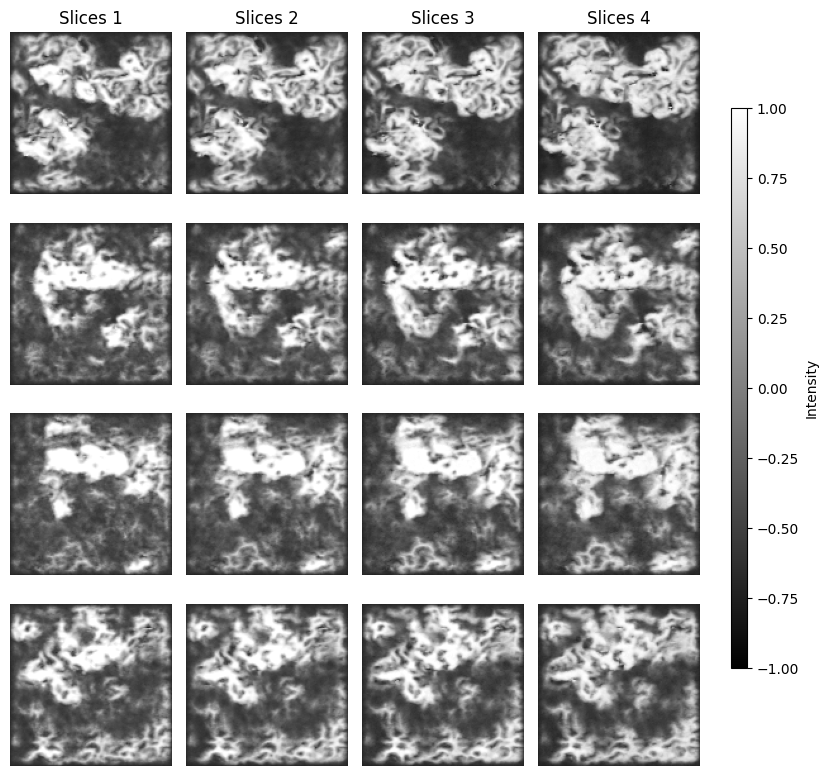

Complete.
Sampling slices 12 to 16...
Generated slices in range [(tensor(-0.9535, device='cuda:0'), tensor(1., device='cuda:0'))]


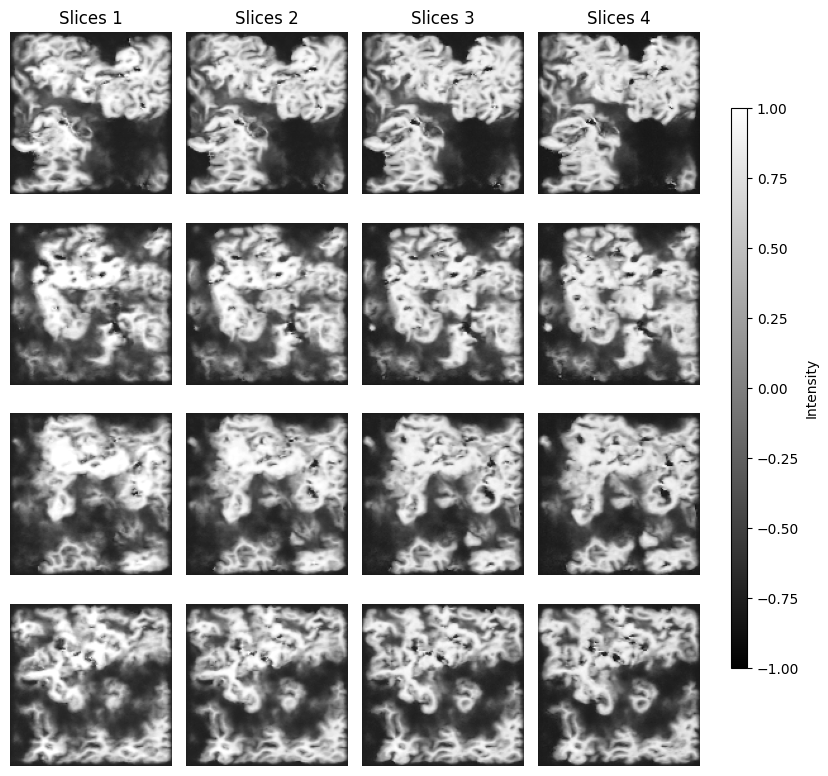

Complete.
Sampling slices 16 to 20...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


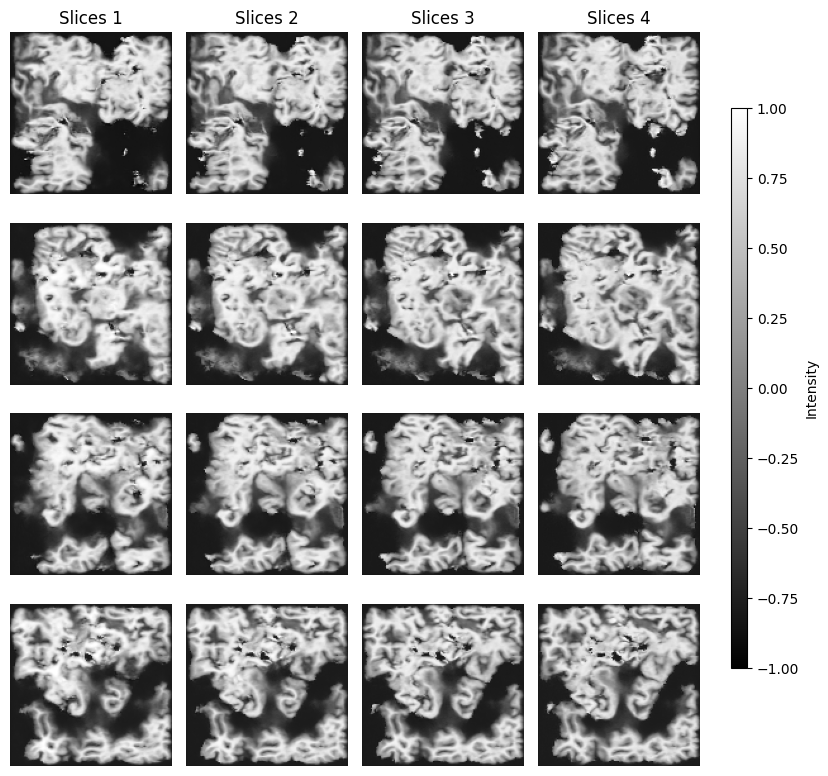

Complete.
Sampling slices 20 to 24...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


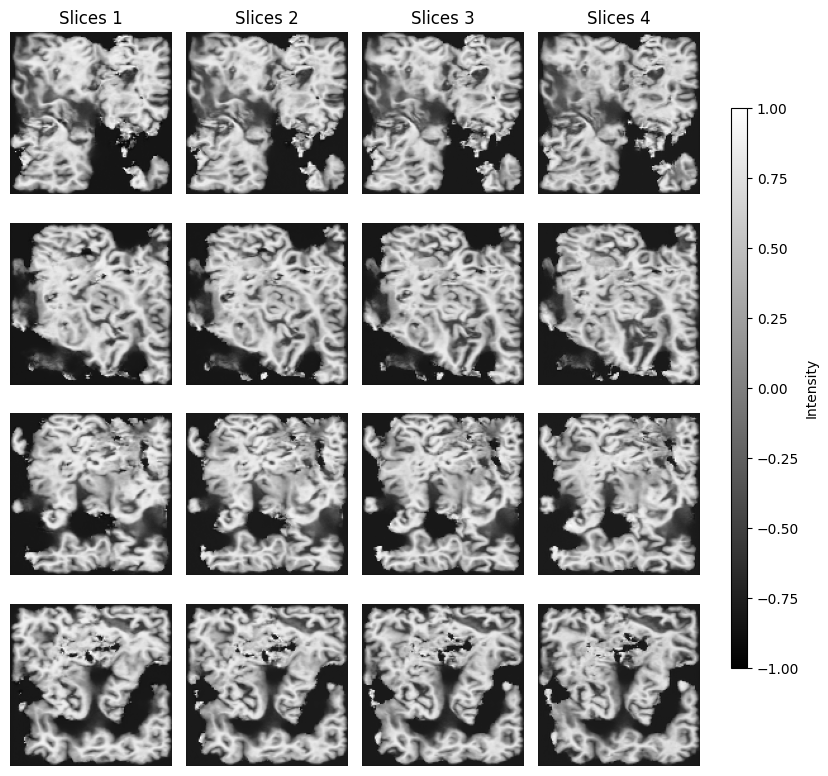

Complete.
Sampling slices 24 to 28...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


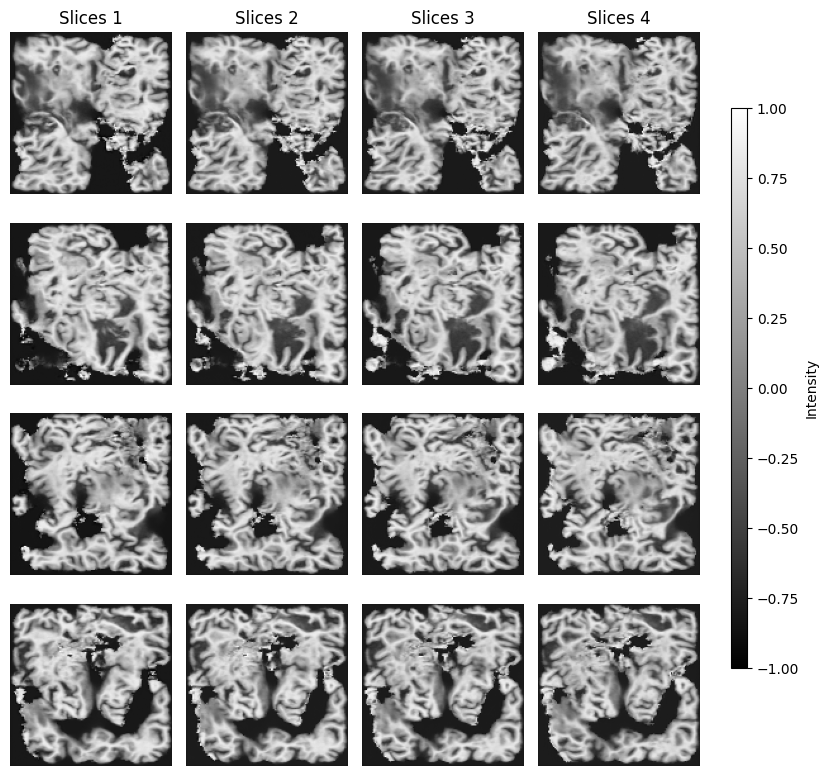

Complete.
Sampling slices 28 to 32...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


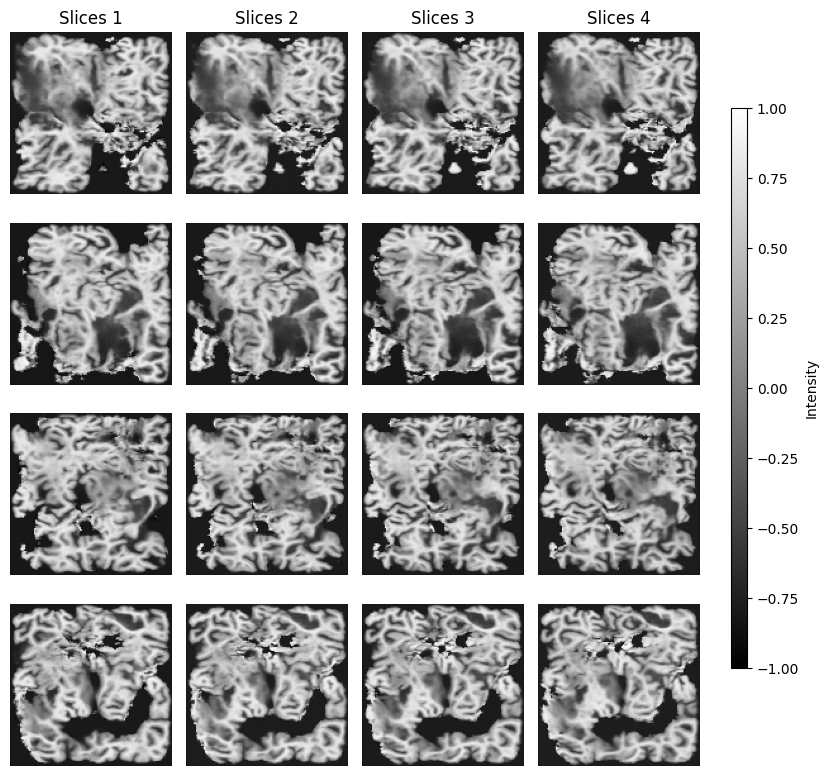

Complete.
Sampling slices 32 to 36...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


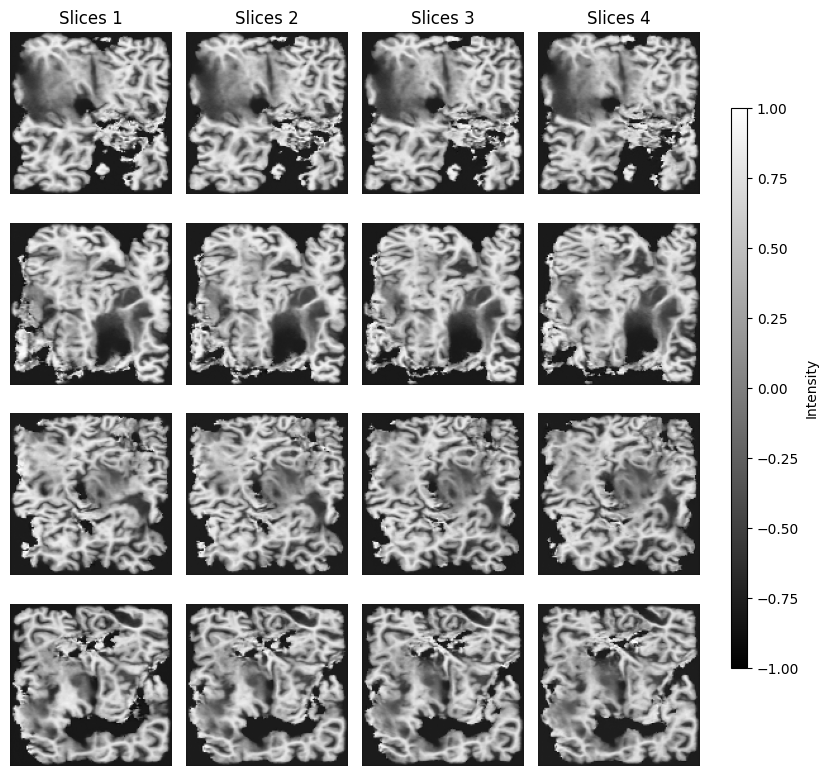

Complete.
Sampling slices 36 to 40...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


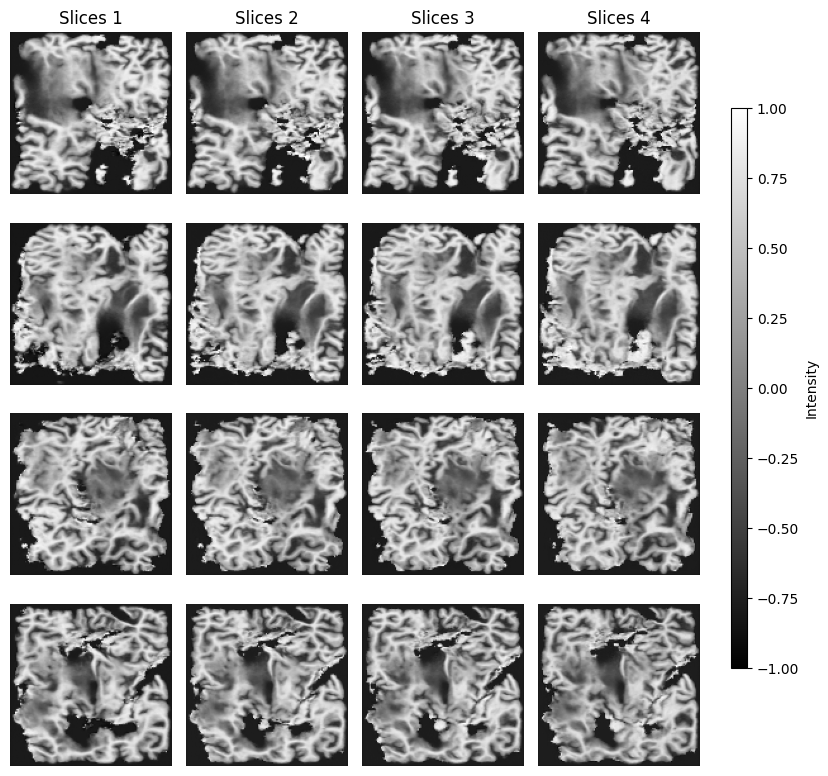

Complete.
Sampling slices 40 to 44...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


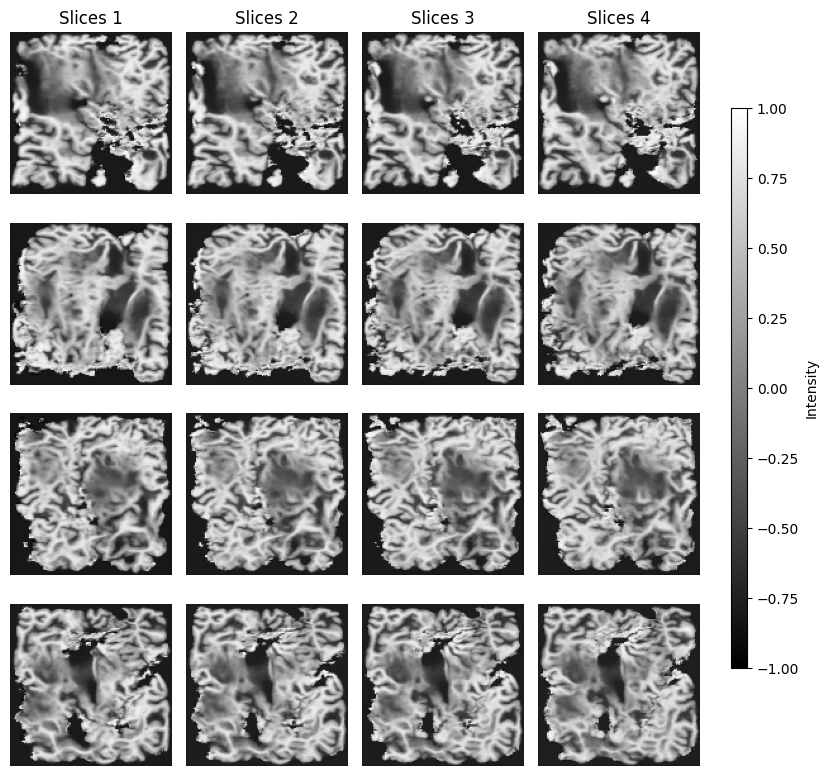

Complete.
Sampling slices 44 to 48...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


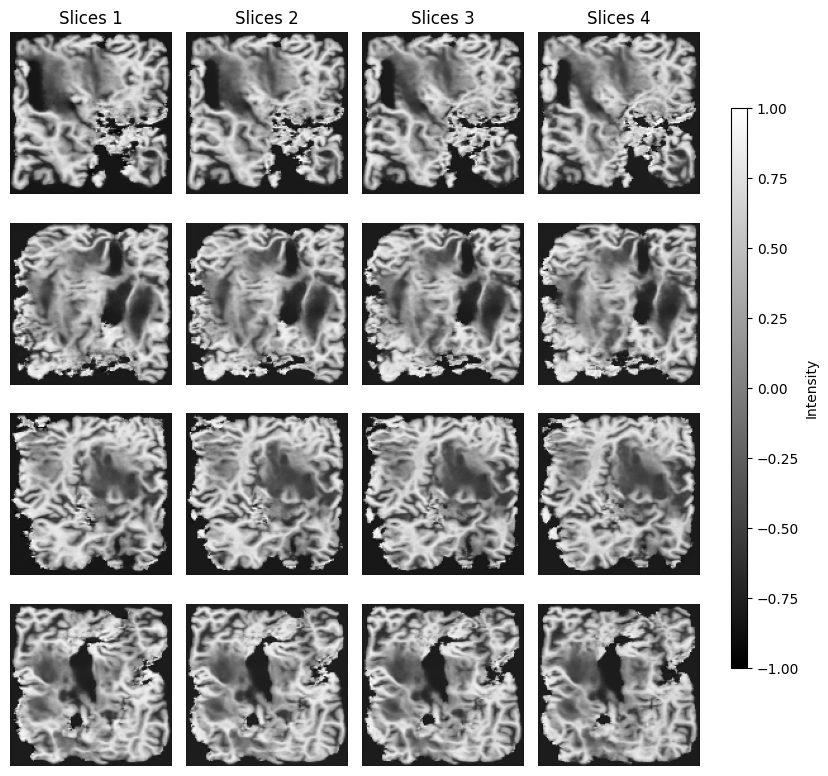

Complete.
Sampling slices 48 to 52...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


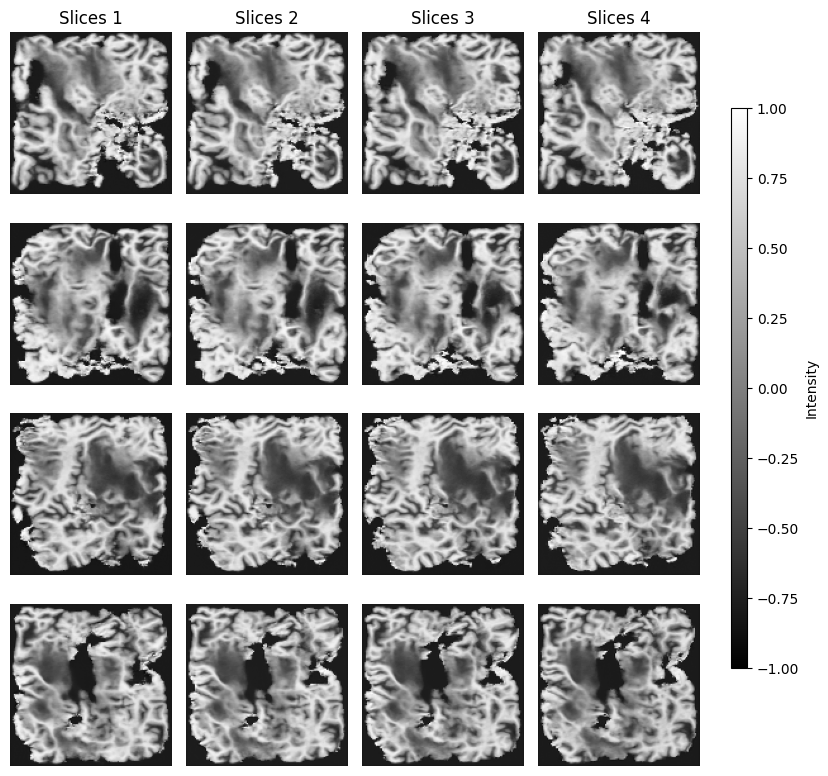

Complete.
Sampling slices 52 to 56...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


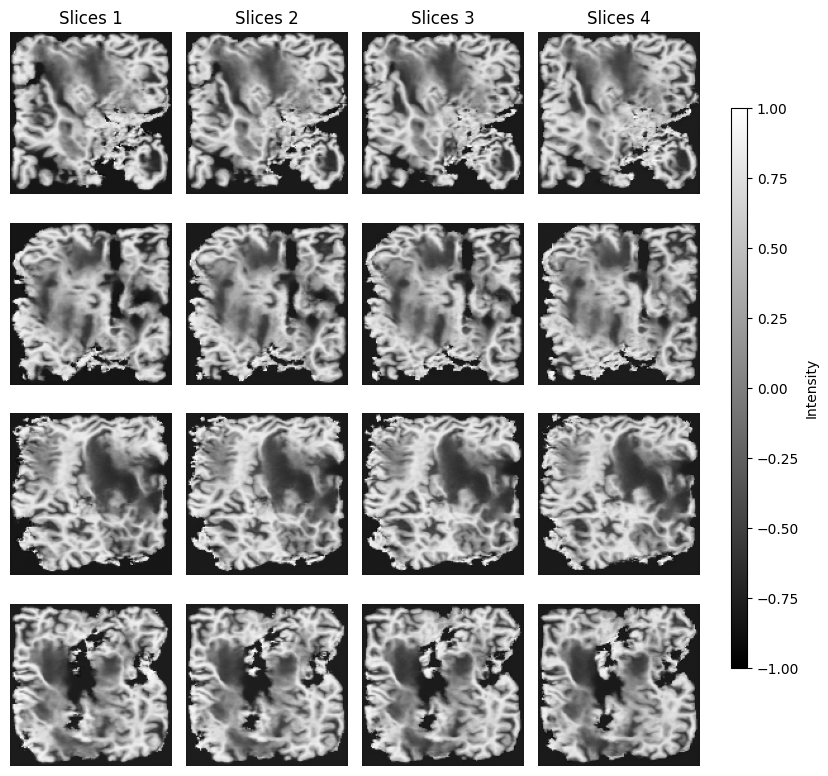

Complete.
Sampling slices 56 to 60...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


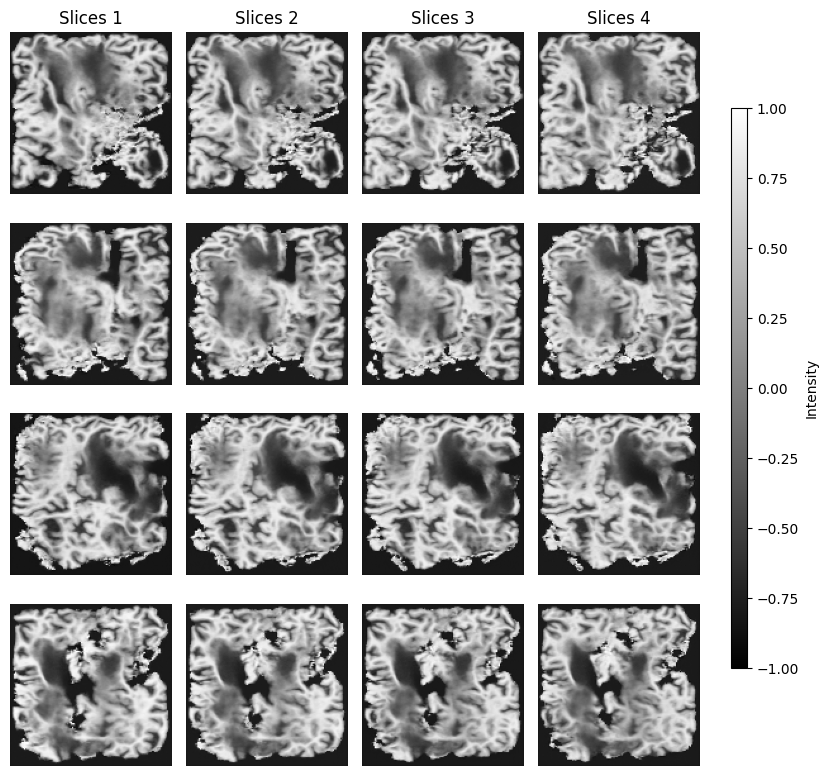

Complete.
Sampling slices 60 to 64...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


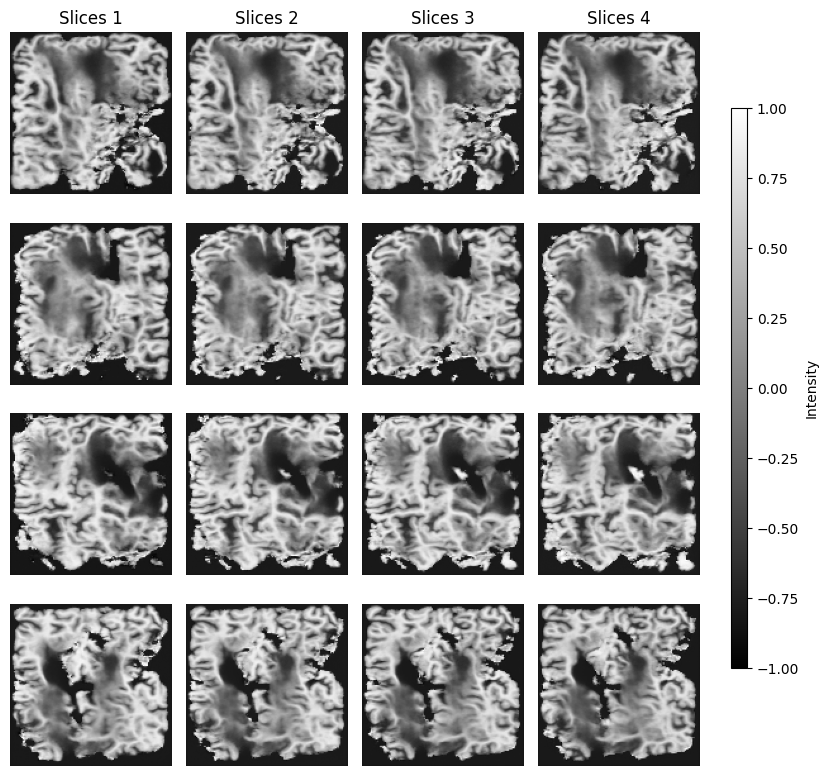

Complete.
Sampling slices 64 to 68...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


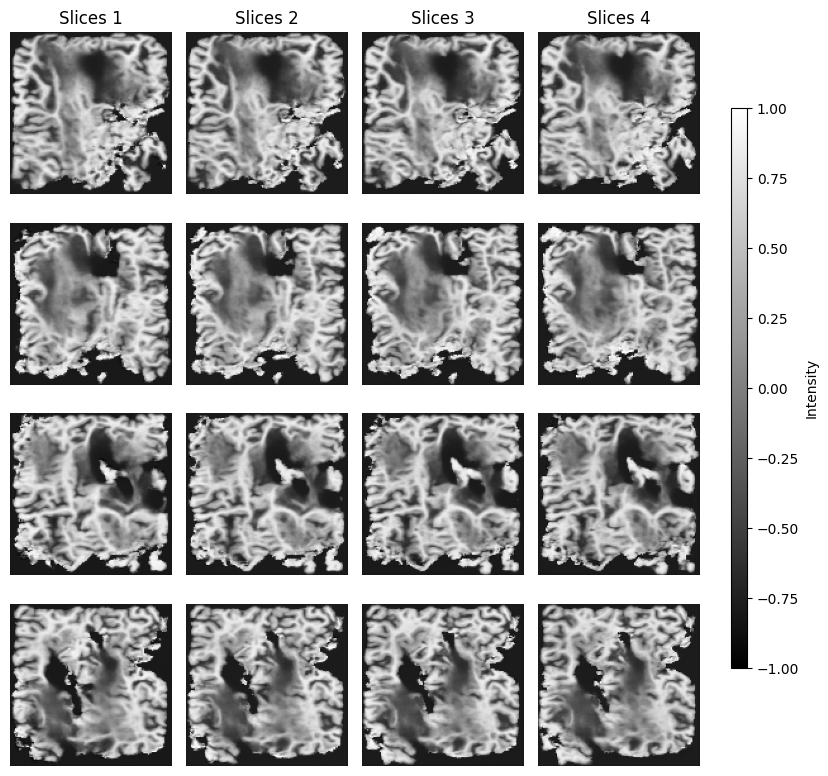

Complete.
Sampling slices 68 to 72...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


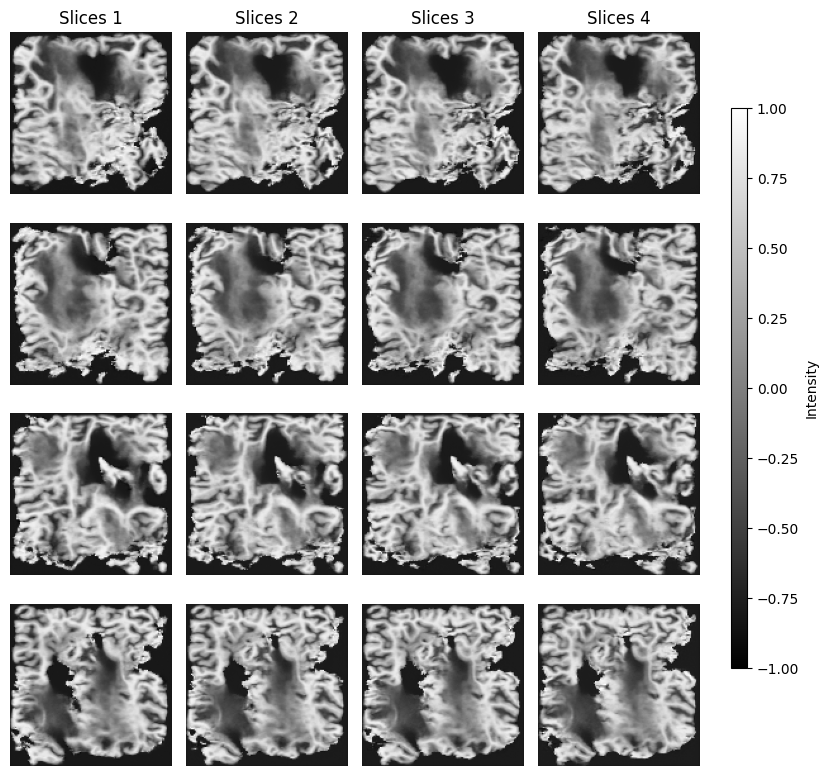

Complete.
Sampling slices 72 to 76...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


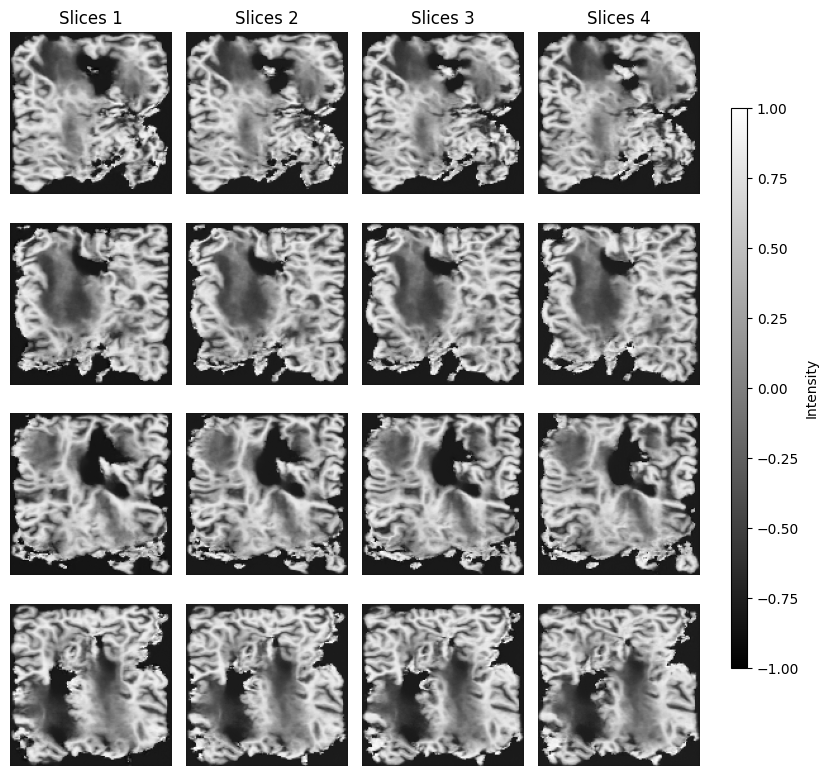

Complete.
Sampling slices 76 to 80...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


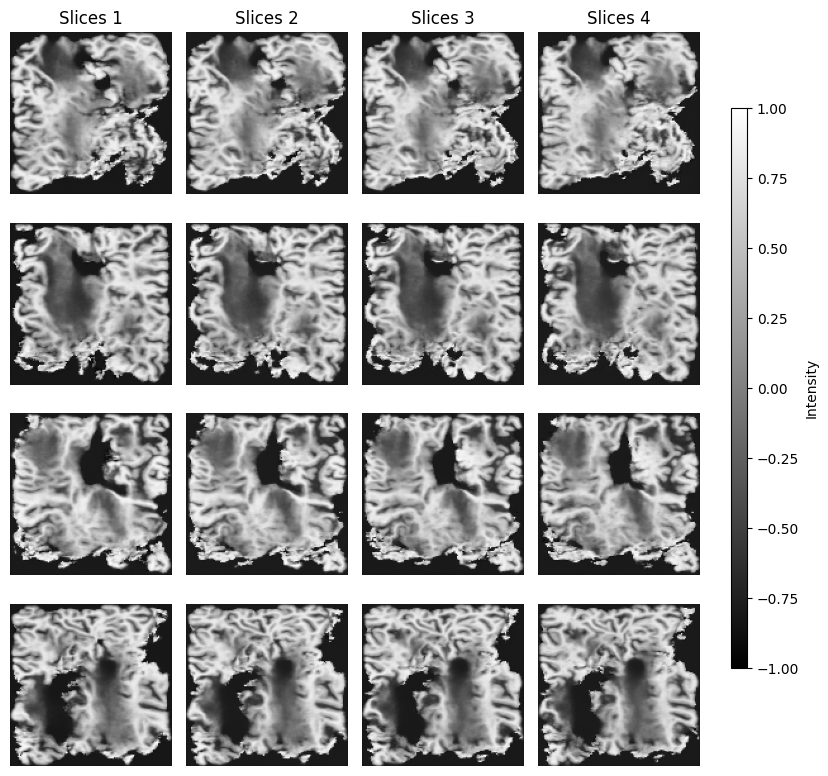

Complete.
Sampling slices 80 to 84...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


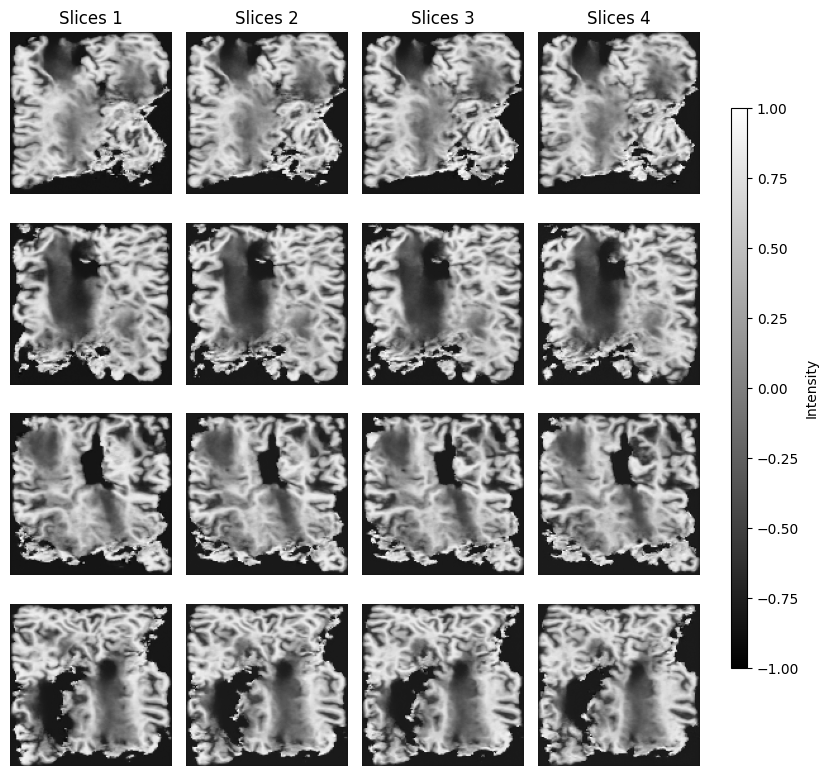

Complete.
Sampling slices 84 to 88...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


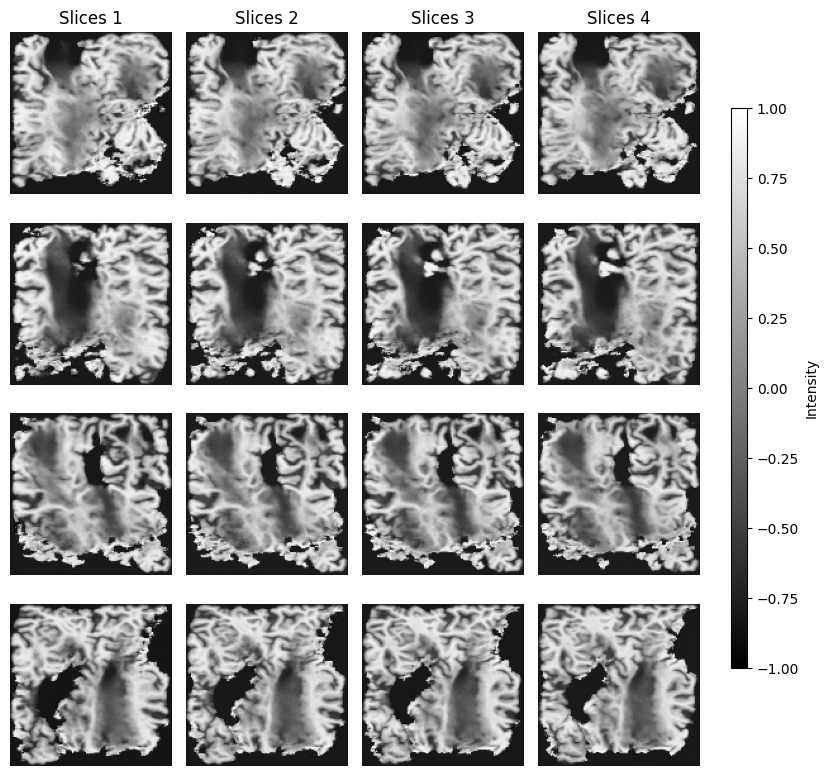

Complete.
Sampling slices 88 to 92...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


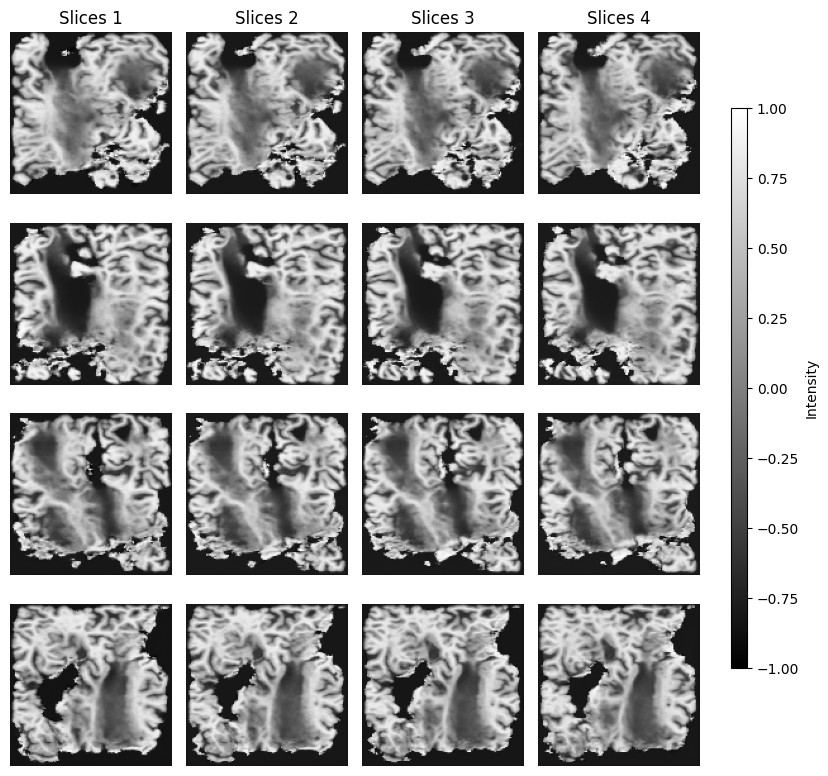

Complete.
Sampling slices 92 to 96...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


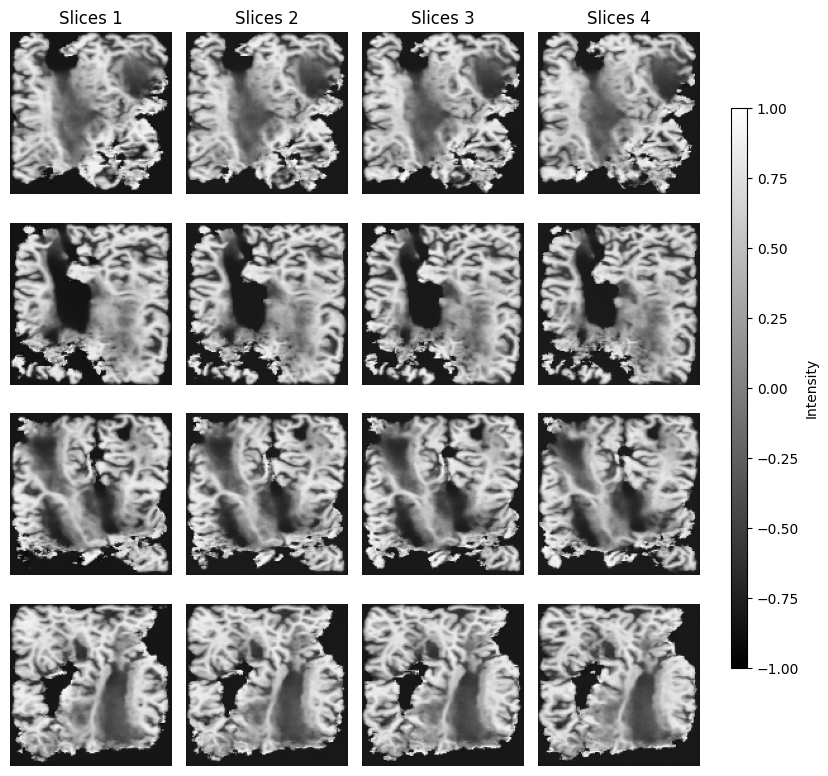

Complete.
Sampling slices 96 to 100...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


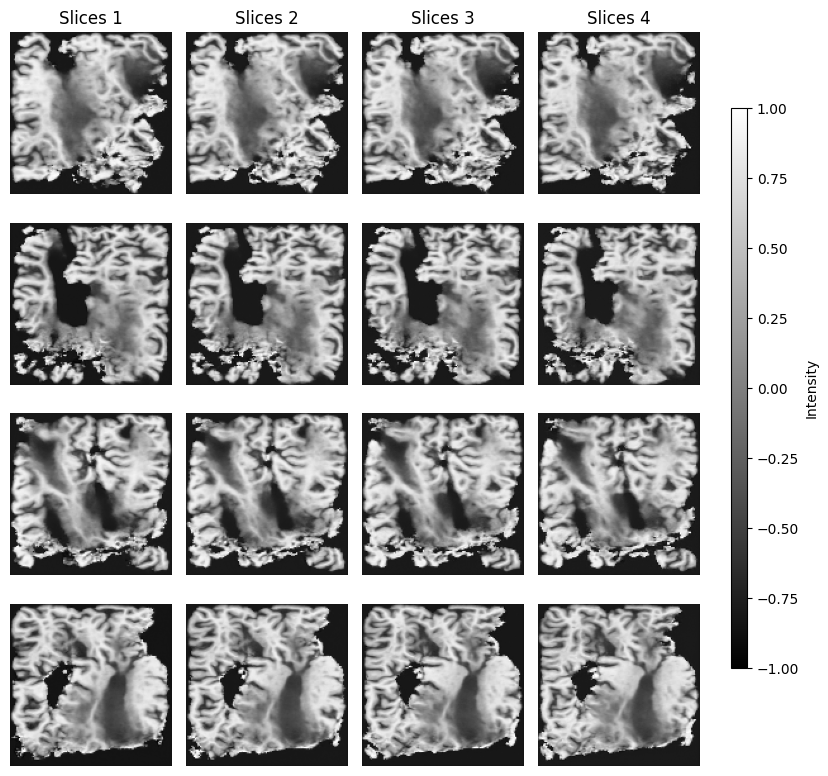

Complete.
Sampling slices 100 to 104...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


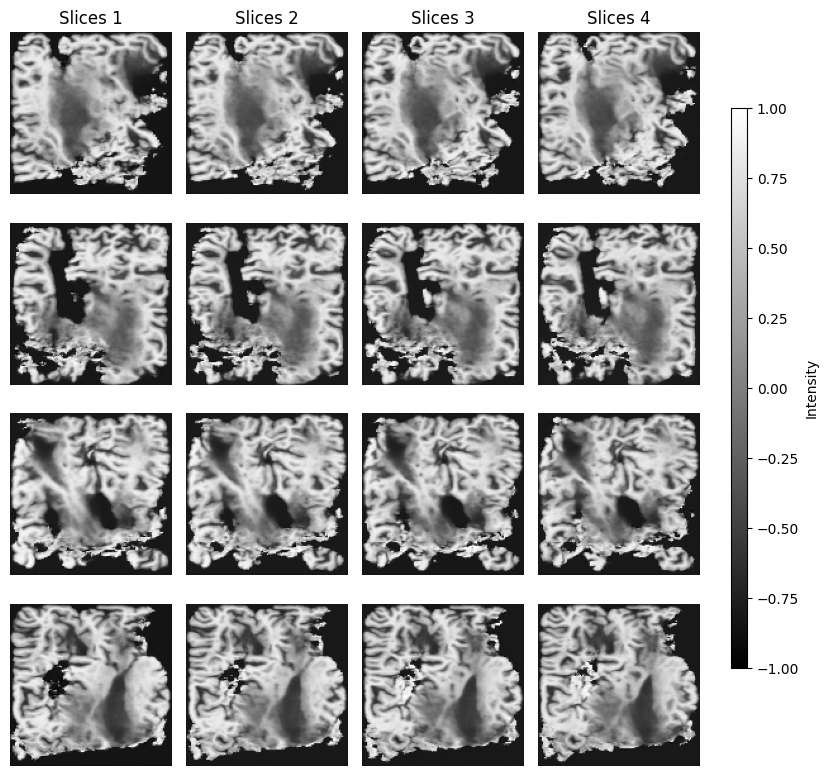

Complete.
Sampling slices 104 to 108...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


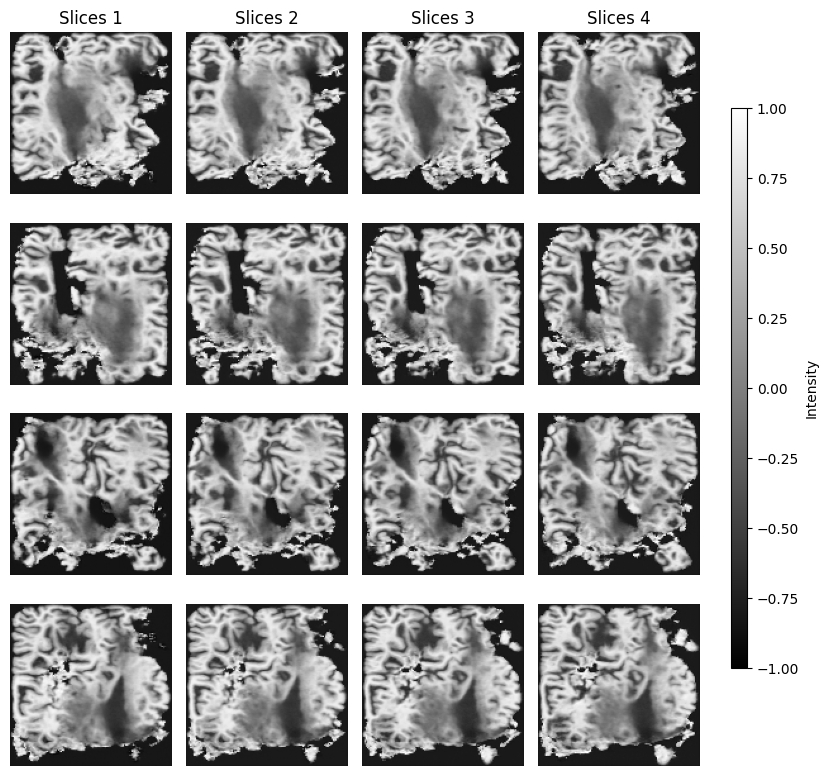

Complete.
Sampling slices 108 to 112...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


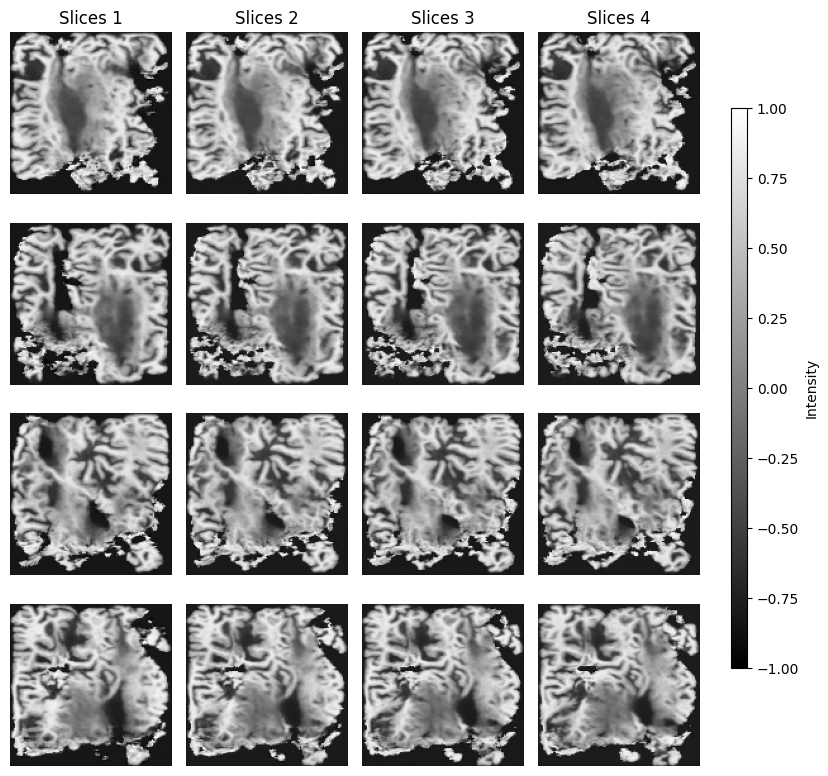

Complete.
Sampling slices 112 to 116...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


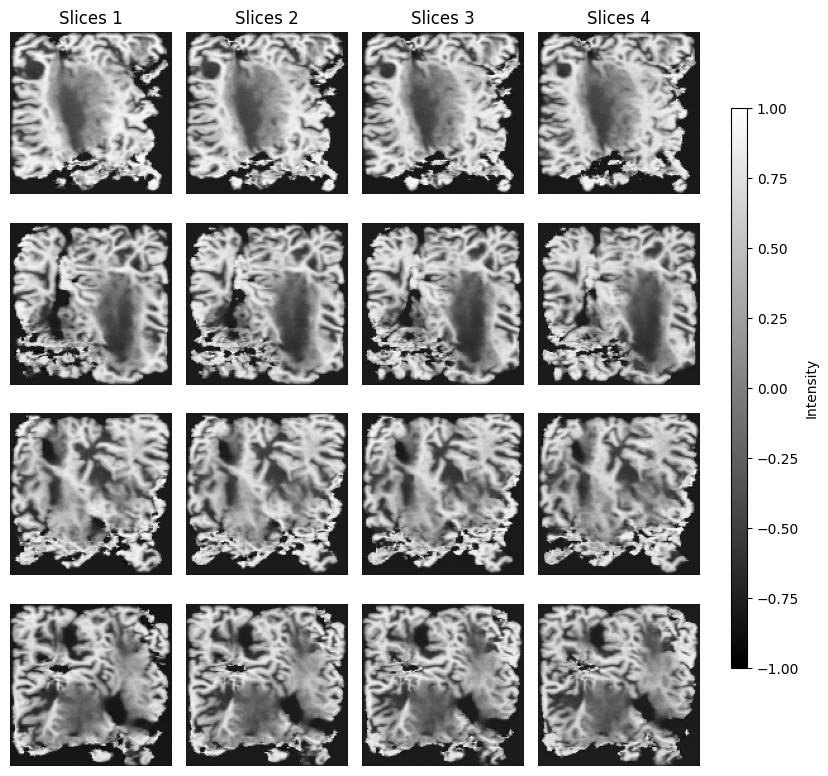

Complete.
Sampling slices 116 to 120...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


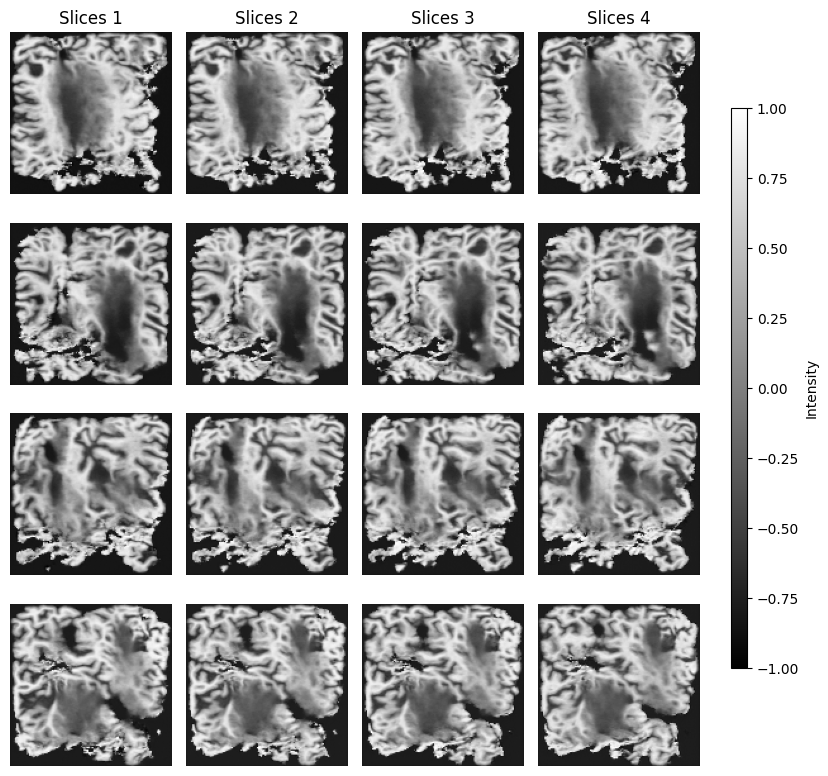

Complete.
Sampling slices 120 to 124...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


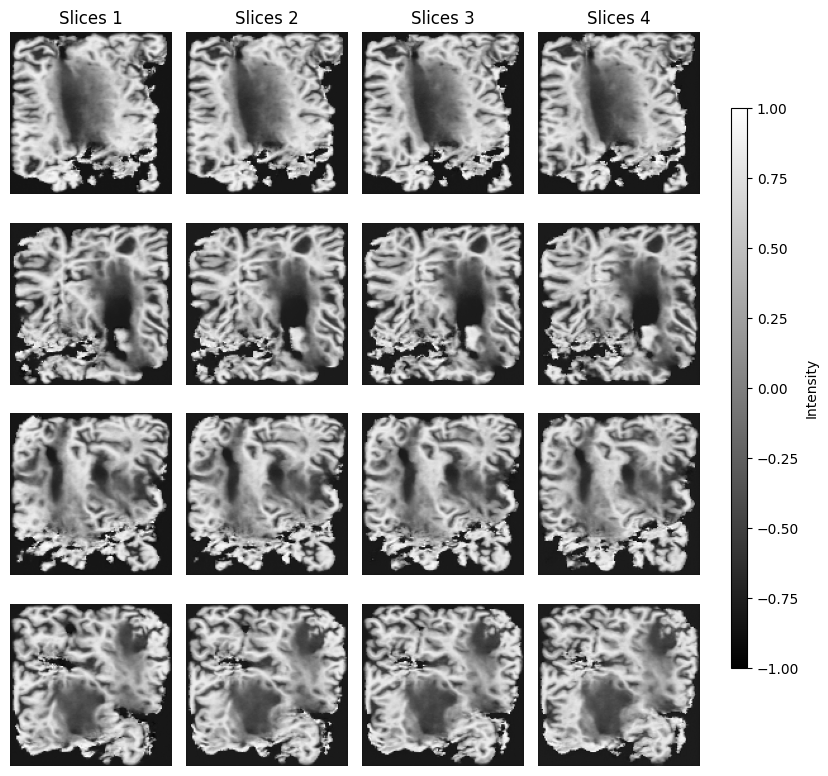

Complete.
Sampling slices 124 to 128...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


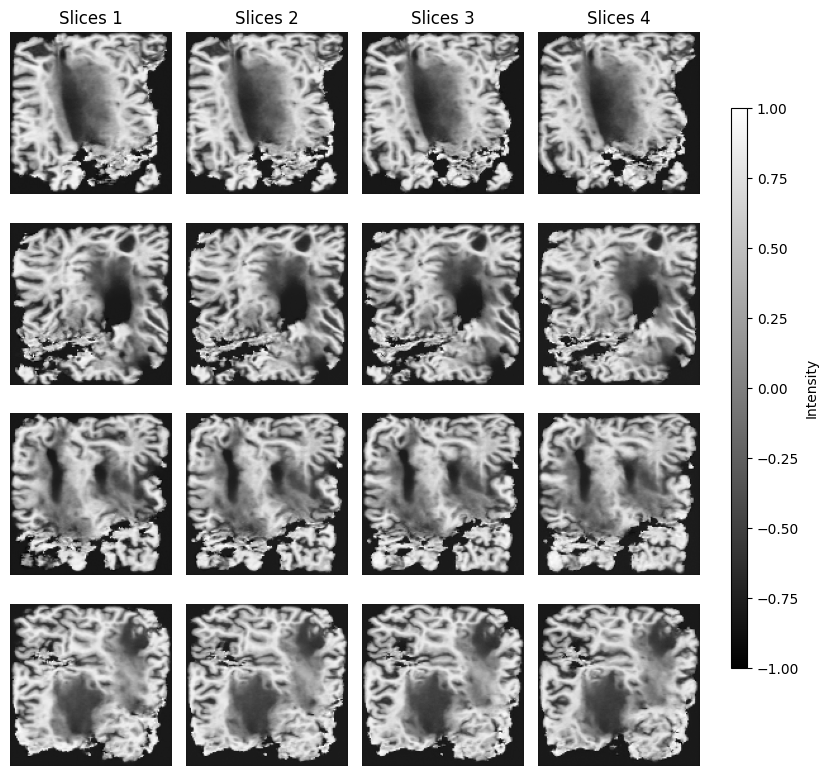

Complete.


In [14]:
output_batch = sample_iteratively(condition_start_index, slices_at_once, one_batch, model, noise_scheduler, None, batch_size, device, symmetric_normalisation, index_encoding_type, verbose=True)

## Experiments 10, 11

In [17]:
num_train_timesteps = 256
experiment_num = '11'
slices_at_once = 2
symmetric_normalisation = True
index_encoding_type = None

In [18]:
model = UNet2DConditionModel(
    sample_size=128,
    in_channels=2*slices_at_once, #16
    out_channels=slices_at_once, #8 #initialise to maximum and compute loss only for indexed slices
    down_block_types=("DownBlock2D", "DownBlock2D", "DownBlock2D", "DownBlock2D", "AttnDownBlock2D"),
    mid_block_type=None,
    up_block_types=("AttnUpBlock2D", "UpBlock2D", "UpBlock2D", "UpBlock2D", "UpBlock2D"),
    # not sure about what the lower arguments do
    block_out_channels=(64, 128, 256, 512, 1024), #start with 64? no deeper than 1024
    layers_per_block=2, #default
    # cross_attention_dim=256, # ~concat one-hot encodings of condition and target slices~ NO now instead just one 128 vector with labels 0,1,2
    attention_head_dim=8, #default
    norm_num_groups=32, #default
    use_linear_projection=True #DIFFERENT
)
print(f"Model initialised. Number of model parameters: {model.num_parameters()}.")
model.to(device)

Model initialised. Number of model parameters: 202131586.


UNet2DConditionModel(
  (conv_in): Conv2d(4, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=64, out_features=256, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=256, out_features=256, bias=True)
  )
  (down_blocks): ModuleList(
    (0): DownBlock2D(
      (resnets): ModuleList(
        (0-1): 2 x ResnetBlock2D(
          (norm1): GroupNorm(32, 64, eps=1e-05, affine=True)
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (time_emb_proj): Linear(in_features=256, out_features=64, bias=True)
          (norm2): GroupNorm(32, 64, eps=1e-05, affine=True)
          (dropout): Dropout(p=0.0, inplace=False)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (nonlinearity): SiLU()
        )
      )
      (downsamplers): ModuleList(
        (0): Downsample2D(
          (conv): Conv2d(64

In [19]:
noise_scheduler = DDPMScheduler(num_train_timesteps=num_train_timesteps)

In [20]:
load_trained_model(model, f'experiment{experiment_num}/latest_ckpt.pth.tar')

/cim/ehoney/ecse626proj/utils.py:102: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(ckpt_path)


Checkpoint loaded from epoch 1500.


In [21]:
noised_target_slices = torch.randn(batch_size, slices_at_once, 128, 128, device=device)

In [22]:
condition_slices = torch.zeros_like(noised_target_slices)

In [23]:
first_target_slice_indices = torch.zeros(4, dtype=torch.int).to(device)

In [24]:
encoder_hidden_states = get_index_encoding(index_encoding_type, first_target_slice_indices, slices_at_once, embedder=None)

In [25]:
target_slices = sample_next_slices(noised_target_slices, condition_slices, model, noise_scheduler, batch_size, device, encoder_hidden_states, verbose=True)

t is 255
t is 254
t is 253
t is 252
t is 251
t is 250
t is 249
t is 248
t is 247
t is 246
t is 245
t is 244
t is 243
t is 242
t is 241
t is 240
t is 239
t is 238
t is 237
t is 236
t is 235
t is 234
t is 233
t is 232
t is 231
t is 230
t is 229
t is 228
t is 227
t is 226
t is 225
t is 224
t is 223
t is 222
t is 221
t is 220
t is 219
t is 218
t is 217
t is 216
t is 215
t is 214
t is 213
t is 212
t is 211
t is 210
t is 209
t is 208
t is 207
t is 206
t is 205
t is 204
t is 203
t is 202
t is 201
t is 200
t is 199
t is 198
t is 197
t is 196
t is 195
t is 194
t is 193
t is 192
t is 191
t is 190
t is 189
t is 188
t is 187
t is 186
t is 185
t is 184
t is 183
t is 182
t is 181
t is 180
t is 179
t is 178
t is 177
t is 176
t is 175
t is 174
t is 173
t is 172
t is 171
t is 170
t is 169
t is 168
t is 167
t is 166
t is 165
t is 164
t is 163
t is 162
t is 161
t is 160
t is 159
t is 158
t is 157
t is 156
t is 155
t is 154
t is 153
t is 152
t is 151
t is 150
t is 149
t is 148
t is 147
t is 146
t is 145
t

/cim/ehoney/ecse626proj/utils.py:143: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Leave space for the colorbar


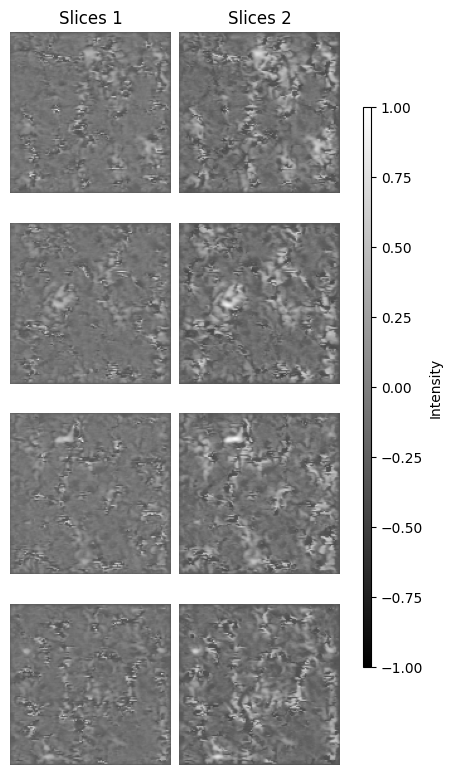

In [26]:
plot_batch_slices(target_slices, batch_size, slices=slices_at_once, vmin=-1)

In [27]:
noised_target_slices = torch.randn(batch_size, slices_at_once, 128, 128, device=device)

In [28]:
data_dir = "/cim/ehoney/ecse626proj/preprocessed_data"
train_dataset = ADNIDatasetSlicesInOrder(data_dir, sample_full_brain=True, symmetric_normalisation=True)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=8) # CHANGE to NUM_WORKERS=4

In [29]:
one_batch = next(iter(train_dataloader))

In [32]:
condition_start_index = 62

Condition slices populated from slice 62 to 64.


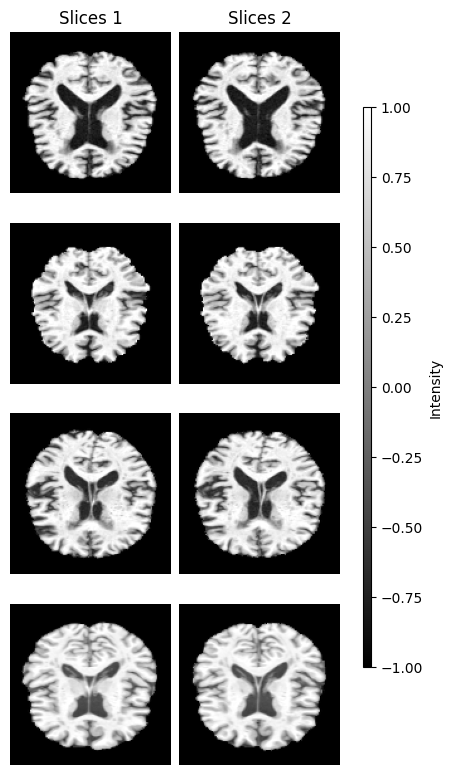

Sampling slices 64 to 66...
Generated slices in range [(tensor(-0.9252, device='cuda:0'), tensor(1., device='cuda:0'))]


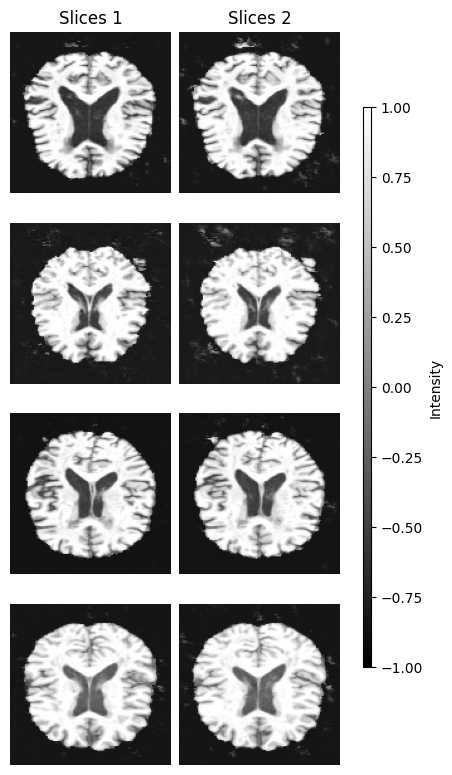

Complete.
Sampling slices 66 to 68...
Generated slices in range [(tensor(-0.9446, device='cuda:0'), tensor(1., device='cuda:0'))]


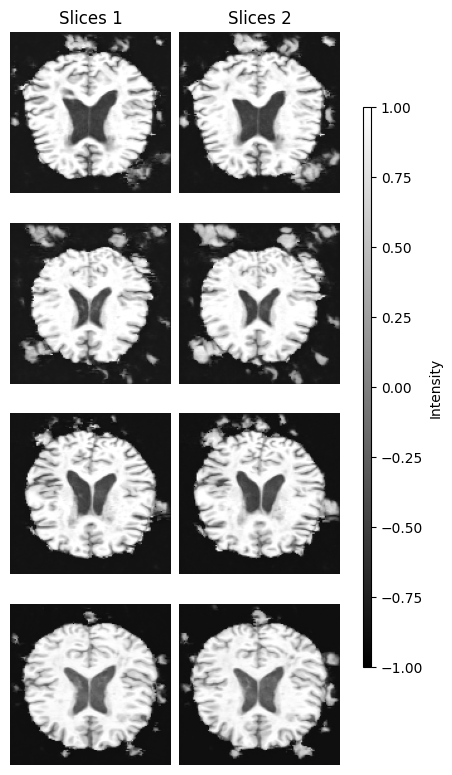

Complete.
Sampling slices 68 to 70...
Generated slices in range [(tensor(-0.9806, device='cuda:0'), tensor(1., device='cuda:0'))]


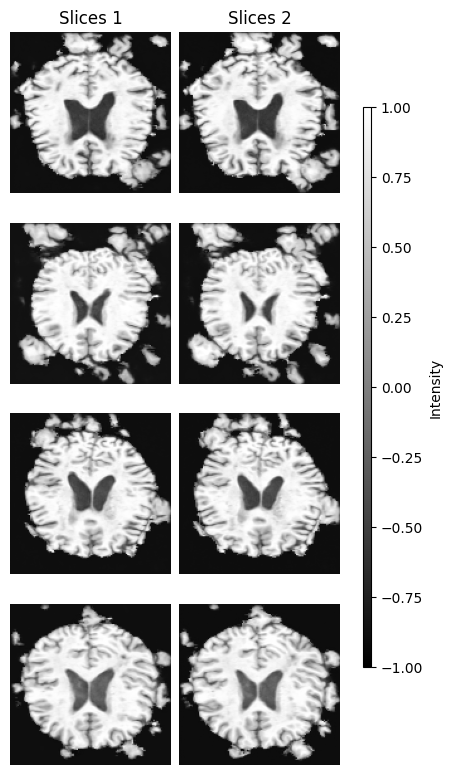

Complete.
Sampling slices 70 to 72...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


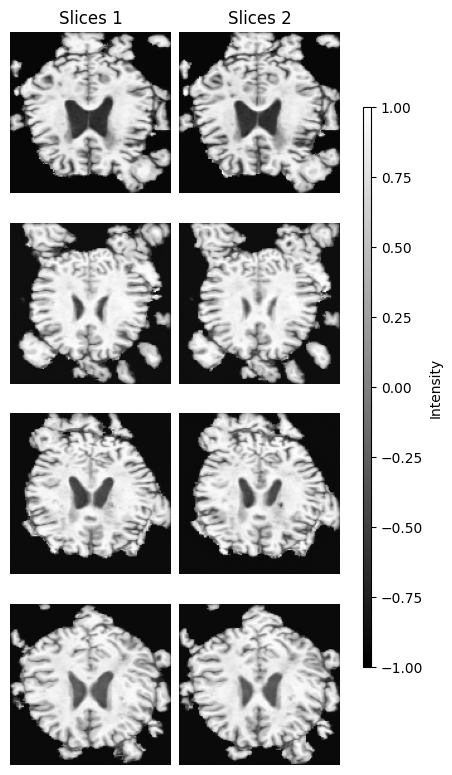

Complete.
Sampling slices 72 to 74...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


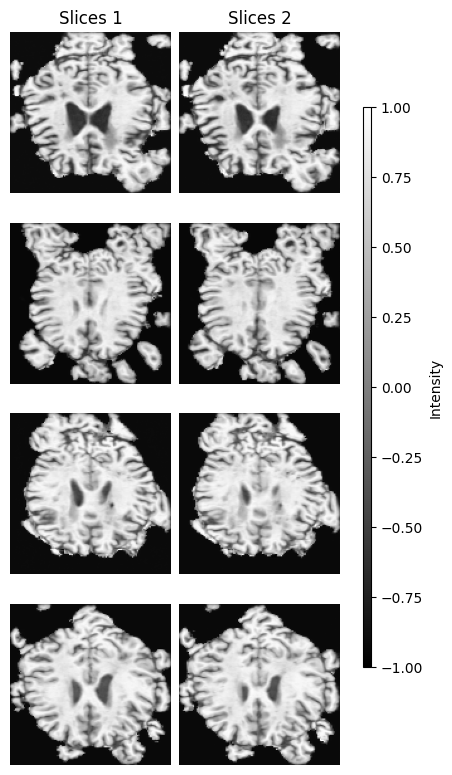

Complete.
Sampling slices 74 to 76...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


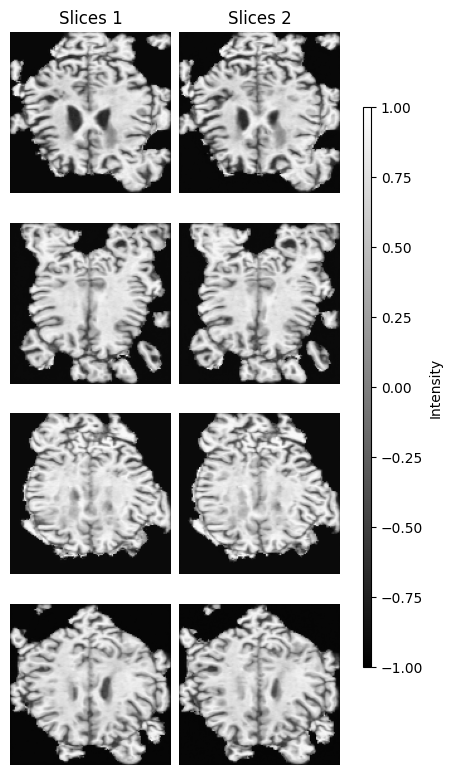

Complete.
Sampling slices 76 to 78...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


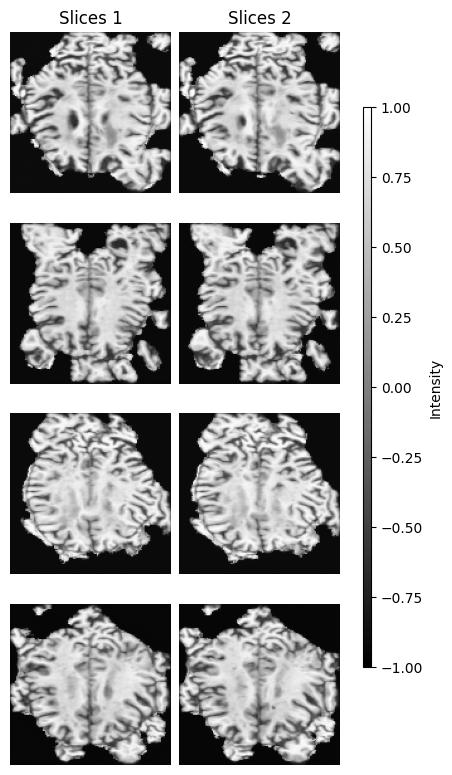

Complete.
Sampling slices 78 to 80...
Generated slices in range [(tensor(-0.9937, device='cuda:0'), tensor(1., device='cuda:0'))]


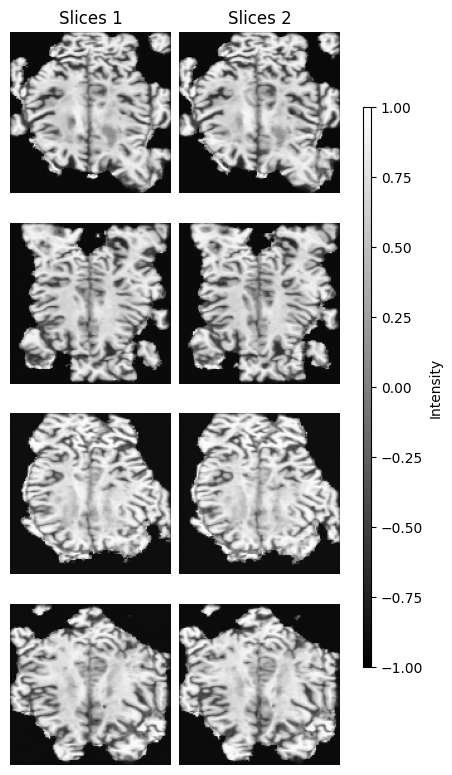

Complete.
Sampling slices 80 to 82...
Generated slices in range [(tensor(-0.9771, device='cuda:0'), tensor(1., device='cuda:0'))]


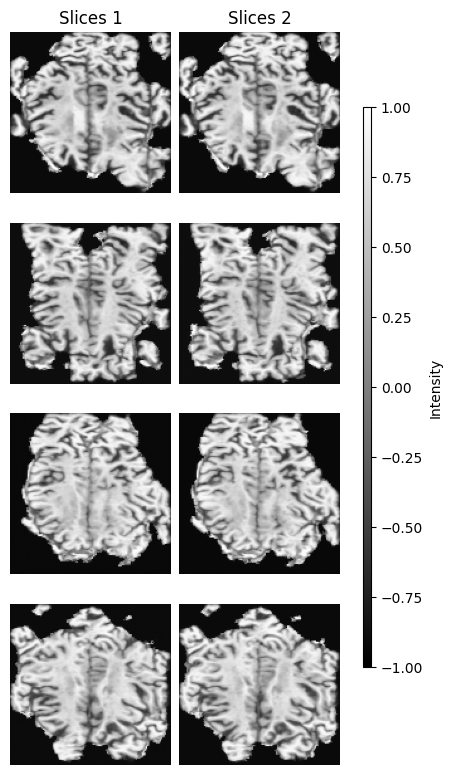

Complete.
Sampling slices 82 to 84...
Generated slices in range [(tensor(-0.9777, device='cuda:0'), tensor(1., device='cuda:0'))]


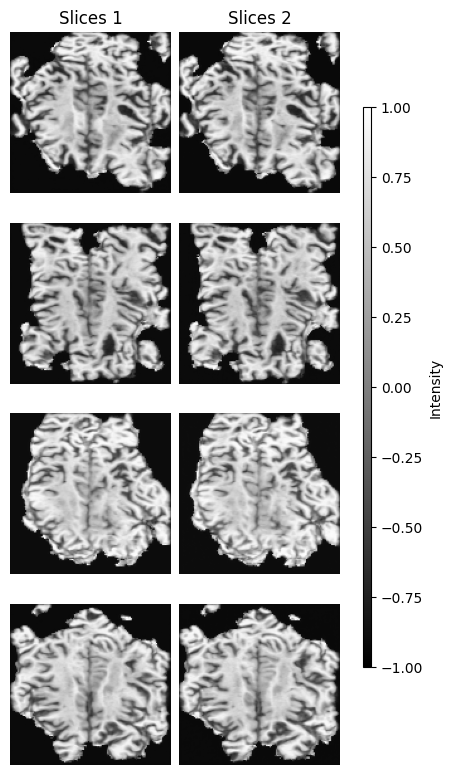

Complete.
Sampling slices 84 to 86...
Generated slices in range [(tensor(-0.9971, device='cuda:0'), tensor(1., device='cuda:0'))]


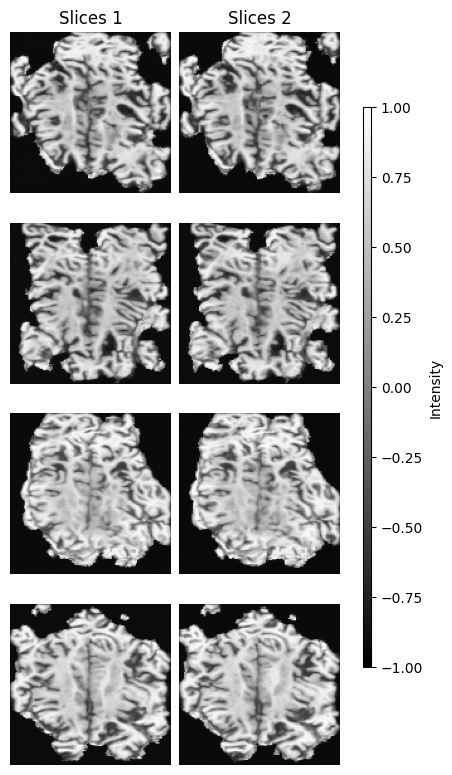

Complete.
Sampling slices 86 to 88...
Generated slices in range [(tensor(-0.9692, device='cuda:0'), tensor(1., device='cuda:0'))]


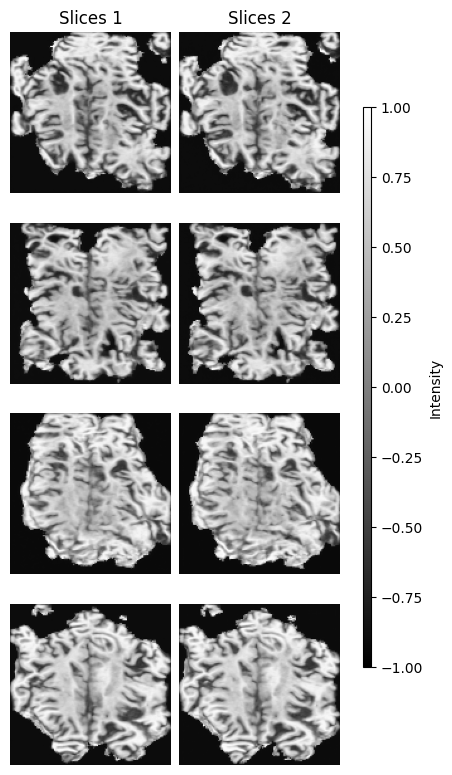

Complete.
Sampling slices 88 to 90...
Generated slices in range [(tensor(-0.9635, device='cuda:0'), tensor(1., device='cuda:0'))]


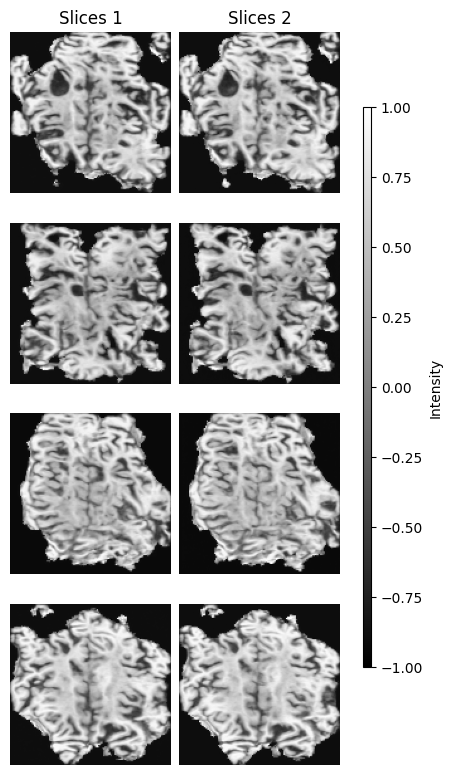

Complete.
Sampling slices 90 to 92...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


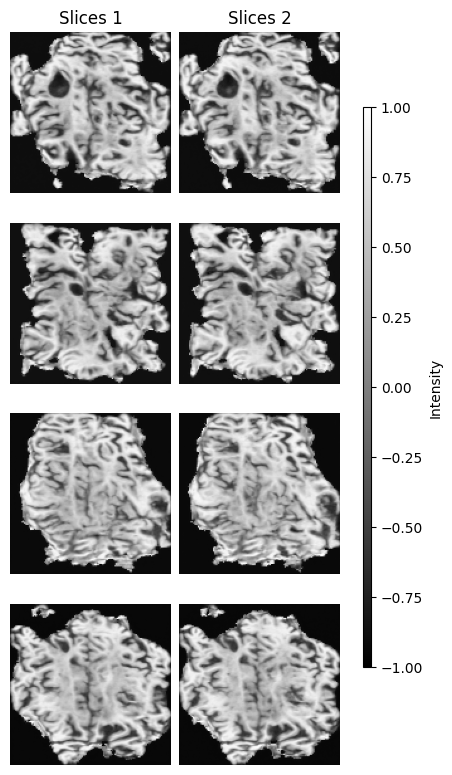

Complete.
Sampling slices 92 to 94...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


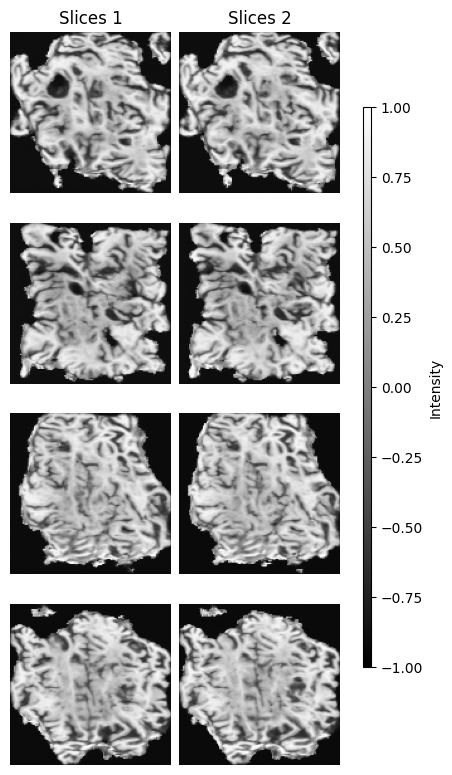

Complete.
Sampling slices 94 to 96...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


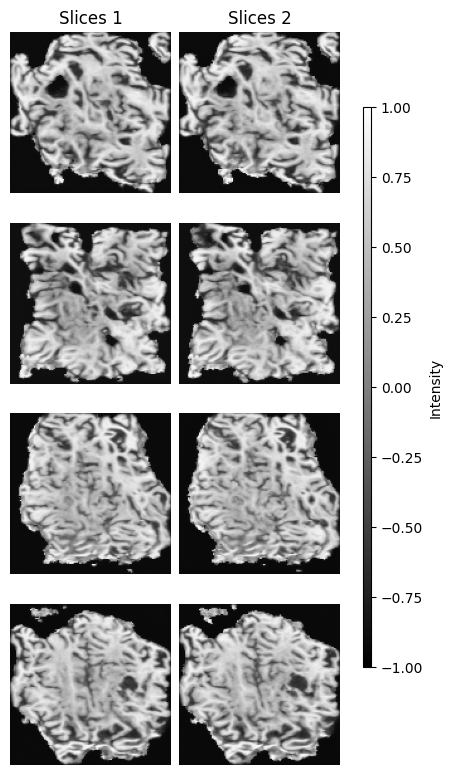

Complete.
Sampling slices 96 to 98...
Generated slices in range [(tensor(-0.9960, device='cuda:0'), tensor(1., device='cuda:0'))]


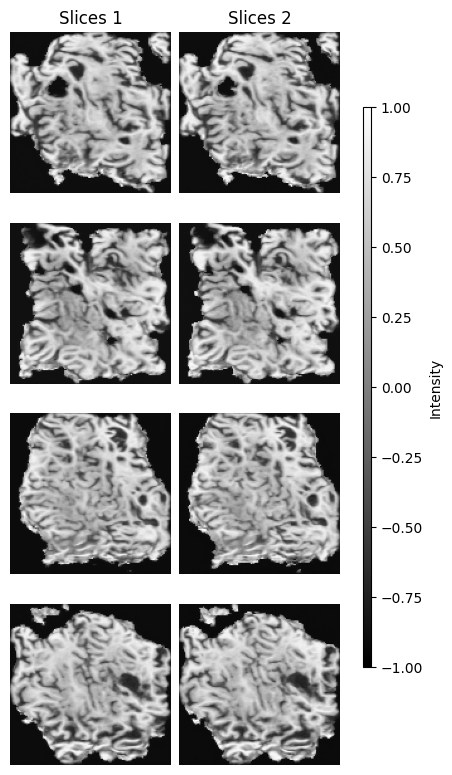

Complete.
Sampling slices 98 to 100...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


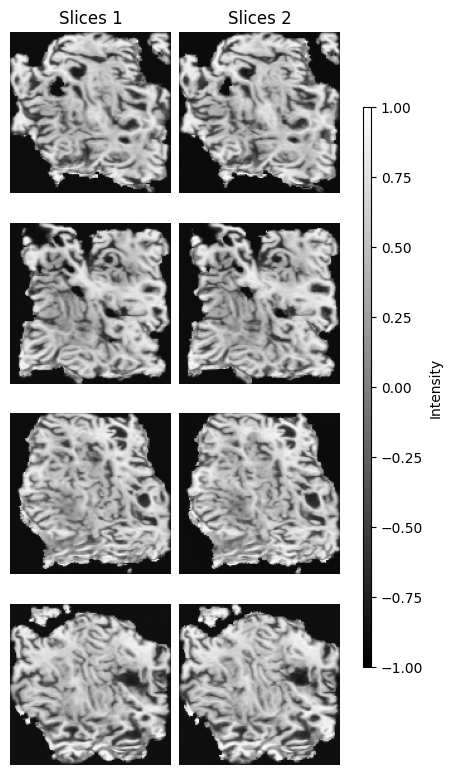

Complete.
Sampling slices 100 to 102...
Generated slices in range [(tensor(-0.9829, device='cuda:0'), tensor(1., device='cuda:0'))]


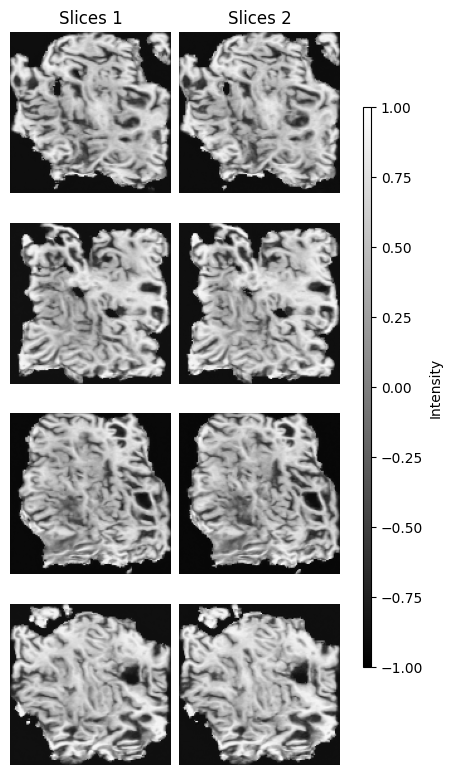

Complete.
Sampling slices 102 to 104...
Generated slices in range [(tensor(-0.9981, device='cuda:0'), tensor(1., device='cuda:0'))]


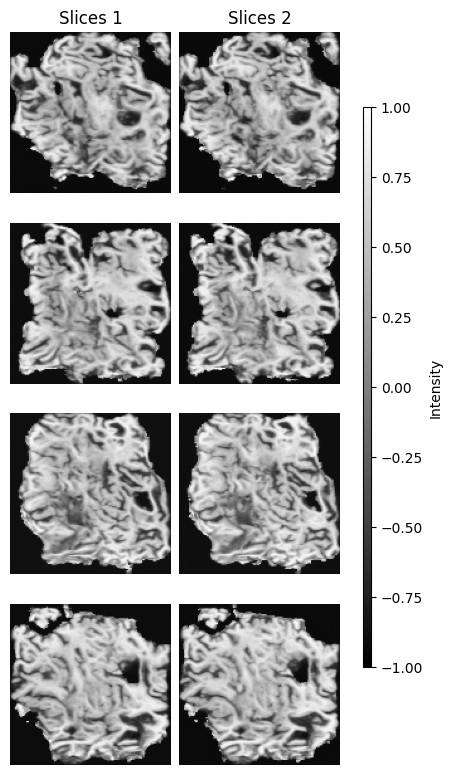

Complete.
Sampling slices 104 to 106...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


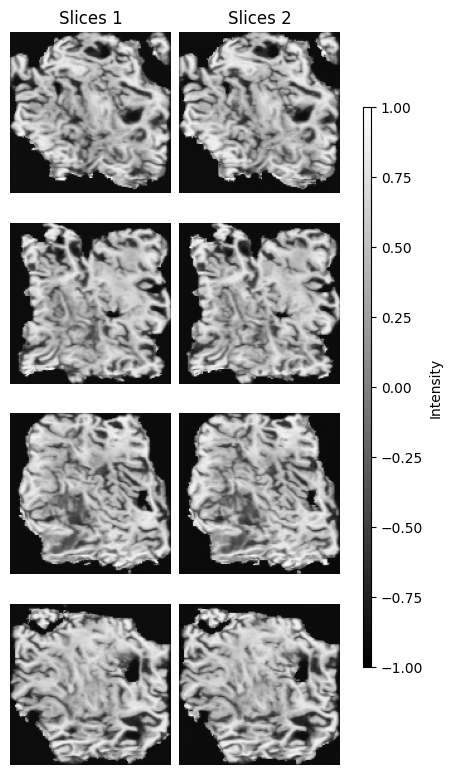

Complete.
Sampling slices 106 to 108...
Generated slices in range [(tensor(-0.9606, device='cuda:0'), tensor(1., device='cuda:0'))]


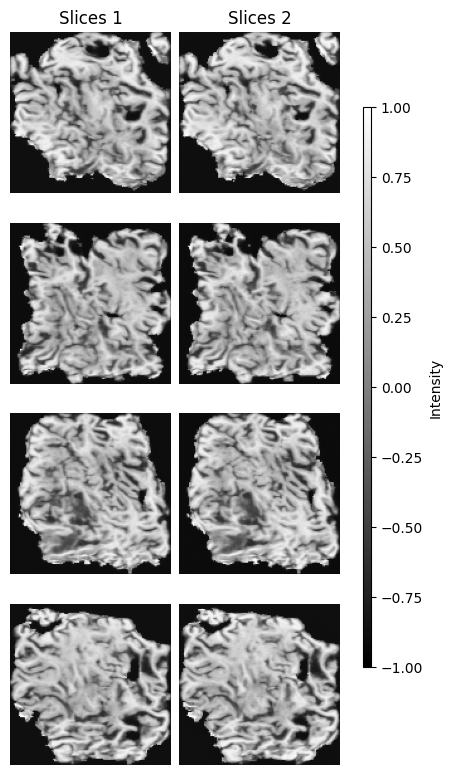

Complete.
Sampling slices 108 to 110...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


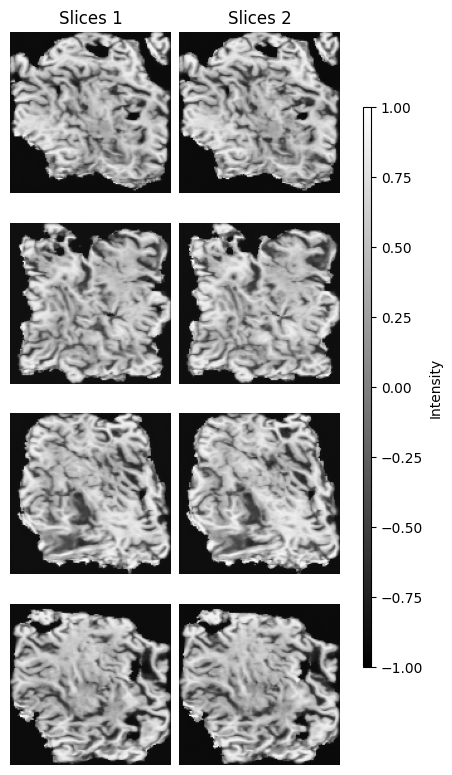

Complete.
Sampling slices 110 to 112...
Generated slices in range [(tensor(-0.9901, device='cuda:0'), tensor(1., device='cuda:0'))]


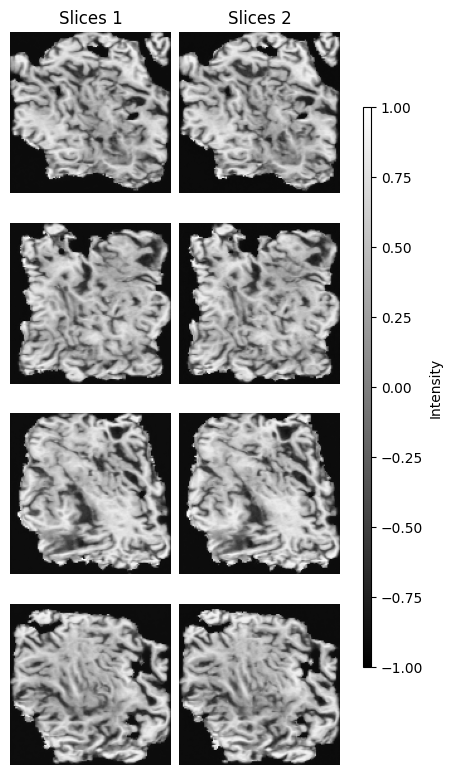

Complete.
Sampling slices 112 to 114...
Generated slices in range [(tensor(-0.9675, device='cuda:0'), tensor(1., device='cuda:0'))]


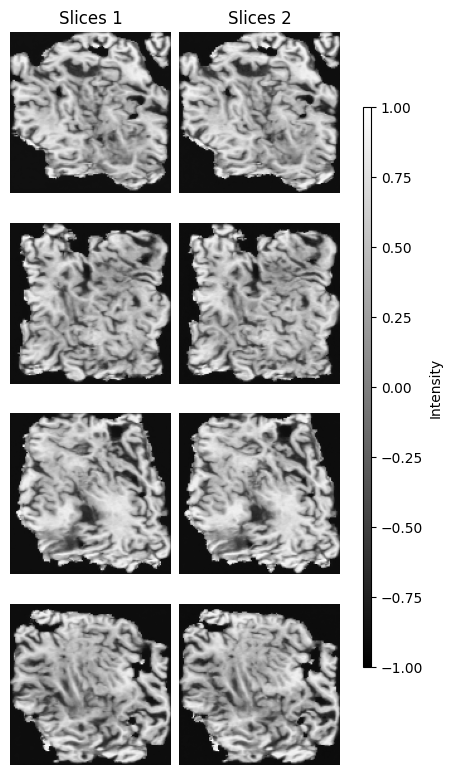

Complete.
Sampling slices 114 to 116...
Generated slices in range [(tensor(-0.9669, device='cuda:0'), tensor(1., device='cuda:0'))]


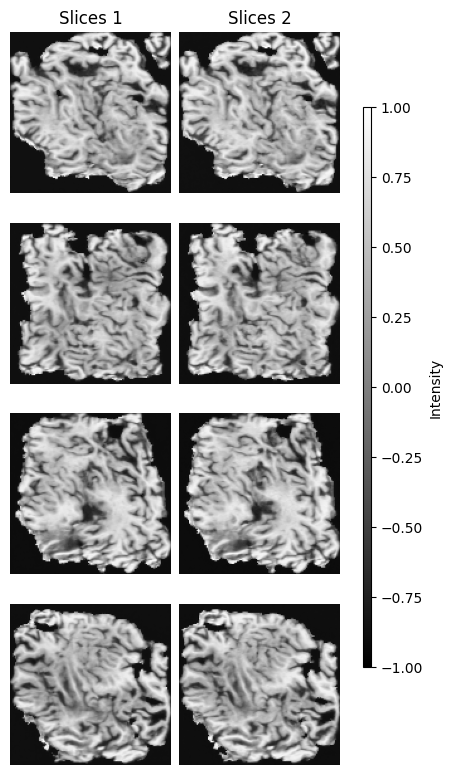

Complete.
Sampling slices 116 to 118...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


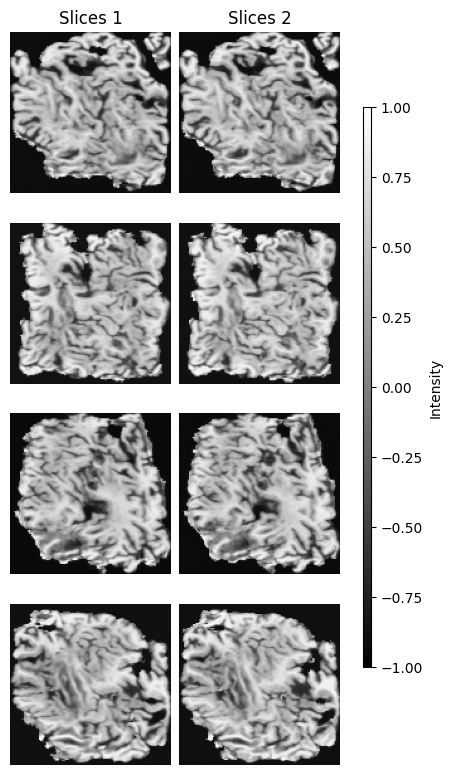

Complete.
Sampling slices 118 to 120...
Generated slices in range [(tensor(-1., device='cuda:0'), tensor(1., device='cuda:0'))]


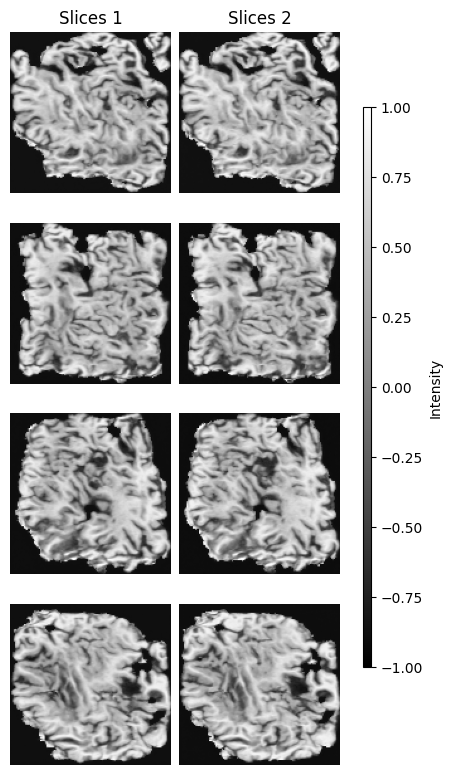

Complete.
Sampling slices 120 to 122...
Generated slices in range [(tensor(-0.9636, device='cuda:0'), tensor(1., device='cuda:0'))]


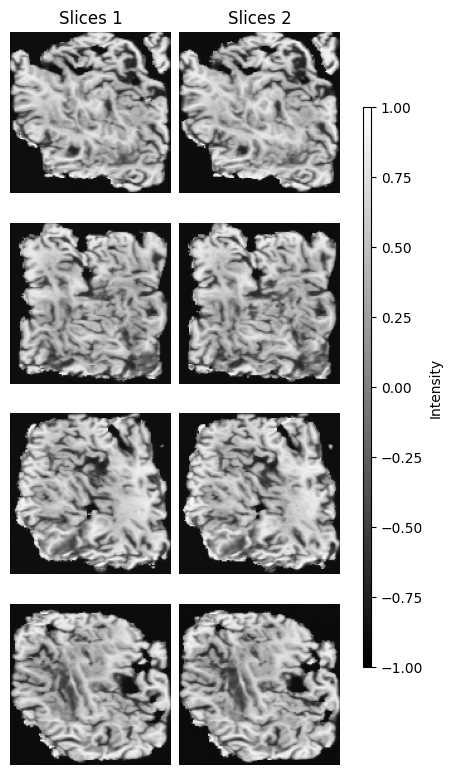

Complete.
Sampling slices 122 to 124...
Generated slices in range [(tensor(-0.9721, device='cuda:0'), tensor(1., device='cuda:0'))]


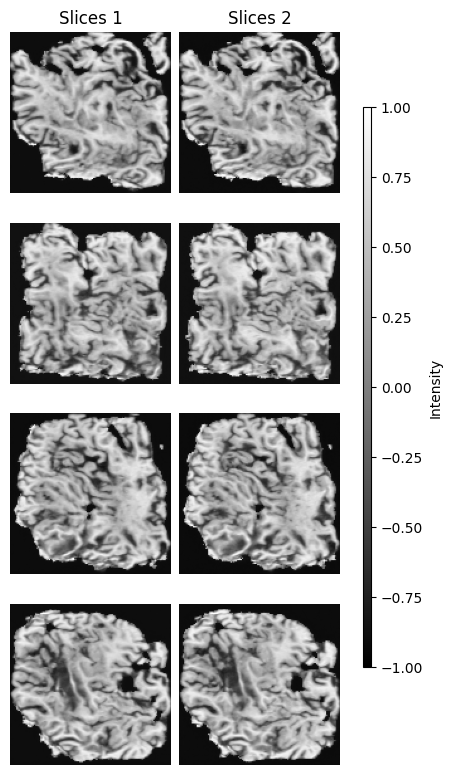

Complete.
Sampling slices 124 to 126...
Generated slices in range [(tensor(-0.9659, device='cuda:0'), tensor(1., device='cuda:0'))]


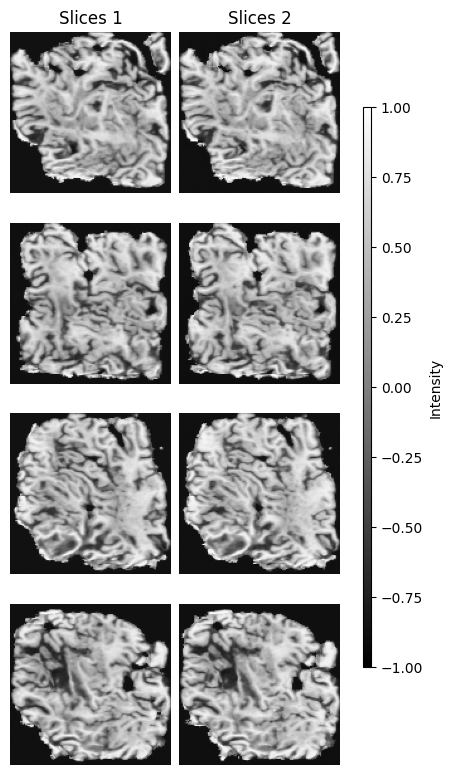

Complete.
Sampling slices 126 to 128...
Generated slices in range [(tensor(-0.9862, device='cuda:0'), tensor(1., device='cuda:0'))]


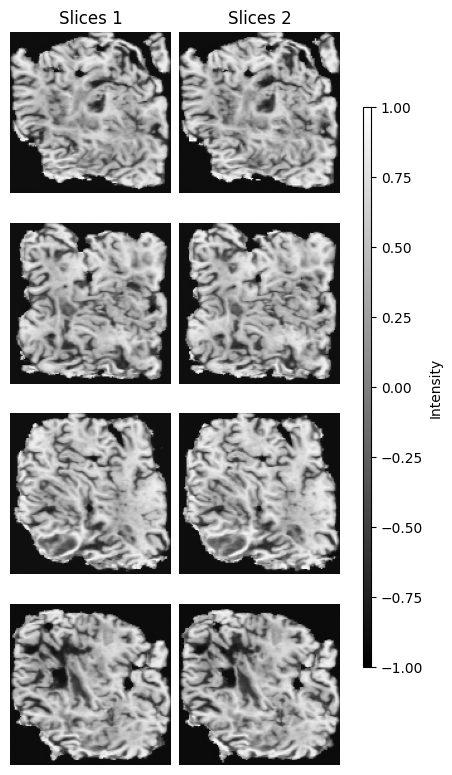

Complete.


In [33]:
output_batch = sample_iteratively(condition_start_index, slices_at_once, one_batch, model, noise_scheduler, None, batch_size, device, symmetric_normalisation, index_encoding_type, verbose=True)